Der verwendete Datensatz "Weather Type Classification" beschäftigt sich mit verschiedenen für das Wetter wichtigen Variablen welche folgendermaßen beschrieben werden:

*   **Temperature (numeric):** The temperature in degrees Celsius, ranging from extreme cold to extreme heat.
*   **Humidity (numeric):** The humidity percentage, including values above 100% to introduce outliers.
*   **Wind Speed (numeric):** The wind speed in kilometers per hour, with a range including unrealistically high values.
*   **Precipitation (%) (numeric):** The precipitation percentage, including outlier values.
*   **Cloud Cover (categorical):** The cloud cover description.
*   **Atmospheric Pressure (numeric):** The atmospheric pressure in hPa, covering a wide range.
*   **UV Index (numeric):** The UV index, indicating the strength of ultraviolet radiation.
*   **Season (categorical):** The season during which the data was recorded.
*   **Visibility (km) (numeric):** The visibility in kilometers, including very low or very high values.
*   Location (categorical): The type of location where the data was recorded.
*   **Weather Type (categorical):** The target variable for classification, indicating the weather type.

Die verwendete Datei wurde von https://www.kaggle.com/datasets/nikhil7280/weather-type-classification/data verwendet und durch Missing Values und doppelte Daten erweitert um noch besser für die gestellte Aufgabe geeignet ist.

Innerhalb dieses Notebooks soll die Temperatur mithilfe einer Linearen Regression, eines Random Forests und eines Light-GBM bestimmt und die Ergebnisse anschließend verglichen werden.

# 1. Importierung der Bibiliotheken und der CSV-Datei

In [2]:
#Import Bibliotheken
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import sklearn.model_selection
import statsmodels.api as sm
import statsmodels.formula.api as smf

#Widgets
import ipywidgets as widgets  # Für die interaktiven Widgets im Jupyter Notebook
from IPython.display import display  # Für die Anzeige des DataFrames in Jupyter

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score


warnings.filterwarnings('ignore') #Hiermit werden Warnungen ignoriert welche nicht die Funktionsfähigkeit des Codes beeinträchtigen (z.B. Versionswarnungen)


# Paket für Funktionen zur Berechnung der Prognosegüte
from sklearn import metrics

# Regression aus sklearn importieren
from sklearn.linear_model import LinearRegression

# Funktionen aus scikit-learn für den Decision Tree importieren
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree

# Random Forest Regressor importieren
from sklearn.ensemble import RandomForestRegressor

# Funktion GridSearchCV importieren
from sklearn.model_selection import GridSearchCV

# Paket für Funktionen zur Berechnung der Prognosegüte
from sklearn import metrics

#lightGBM
import lightgbm as lgb
from lightgbm import LGBMRegressor
from lightgbm import early_stopping

import optuna
# Funktion cross_val_score importieren (wird für optuna benötigt)
from sklearn.model_selection import cross_val_score, KFold

In [3]:
#Import Daten
df = pd.read_csv("weather_classification_data.csv")

# 2. Orientierung in Datenpaket und Bereinigung der Daten

Zu Beginn wird ein umfassender Überblick über das Notebook und die zugrunde liegenden Daten gewonnen. Dazu gehören unter anderem die Betrachtung der Dimensionen des Datensatzes sowie der Spalten und deren Datentypen. Anschließend wird der Datensatz auf doppelte Zeilen überprüft, die bei Bedarf entfernt werden, um Redundanzen zu vermeiden. Fehlende Werte (Missing Values) werden durch den Mittelwert der entsprechenden Spalte ersetzt, um die Konsistenz der Daten zu gewährleisten. Darüber hinaus werden Zeilen, die unrealistische Werte enthalten – wie in der Beschreibung auf der Website bereits angedeutet – identifiziert und entfernt, um die Qualität und Zuverlässigkeit der Daten sicherzustellen.

In [4]:
df

,Temperature,Humidity,Wind Speed,Precipitation (%),Cloud Cover,Atmospheric Pressure,UV Index,Season,Visibility (km),Location,Weather Type
0,14.0,73,9.5,82.0,partly cloudy,1010.82,2,Winter,3.5,inland,Rainy
1,39.0,96,8.5,71.0,partly cloudy,1011.43,7,Spring,10.0,inland,Cloudy
2,30.0,64,7.0,16.0,clear,1018.72,5,Spring,5.5,mountain,Sunny
3,38.0,83,1.5,82.0,clear,1026.25,7,Spring,1.0,coastal,Sunny
4,27.0,74,17.0,66.0,overcast,990.67,1,Winter,2.5,mountain,Rainy
...,...,...,...,...,...,...,...,...,...,...,...
13214,10.0,74,14.5,71.0,overcast,1003.15,1,Summer,1.0,mountain,Rainy
13215,-1.0,76,3.5,23.0,cloudy,1067.23,1,Winter,6.0,coastal,Snowy
13216,30.0,77,5.5,28.0,overcast,1012.69,3,Autumn,9.0,coastal,Cloudy
13217,3.0,76,10.0,94.0,overcast,984.27,0,Winter,2.0,inland,Snowy


In [5]:
df.describe()

,Temperature,Humidity,Wind Speed,Precipitation (%),Atmospheric Pressure,UV Index,Visibility (km)
count,13214.000000,13219.000000,13219.000000,13219.000000,13219.000000,13219.000000,13219.000000
mean,19.121689,68.703155,9.831114,53.638021,1005.839666,4.004842,5.462592
std,17.385119,20.193850,6.906473,31.946433,37.187492,3.855890,3.370536
min,-25.000000,20.000000,0.000000,0.000000,800.120000,0.000000,0.000000
25%,4.000000,57.000000,5.000000,19.000000,994.800000,1.000000,3.000000
50%,21.000000,70.000000,9.000000,58.000000,1007.660000,3.000000,5.000000
75%,31.000000,84.000000,13.500000,82.000000,1016.780000,7.000000,7.500000
max,109.000000,109.000000,48.500000,109.000000,1199.210000,14.000000,20.000000


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13219 entries, 0 to 13218
Data columns (total 11 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature           13214 non-null  float64
 1   Humidity              13219 non-null  int64  
 2   Wind Speed            13219 non-null  float64
 3   Precipitation (%)     13219 non-null  float64
 4   Cloud Cover           13219 non-null  object 
 5   Atmospheric Pressure  13219 non-null  float64
 6   UV Index              13219 non-null  int64  
 7   Season                13219 non-null  object 
 8   Visibility (km)       13219 non-null  float64
 9   Location              13219 non-null  object 
 10  Weather Type          13219 non-null  object 
dtypes: float64(5), int64(2), object(4)
memory usage: 1.1+ MB


In [7]:
df.nunique()

Temperature              126
Humidity                  90
Wind Speed                97
Precipitation (%)        110
Cloud Cover                4
Atmospheric Pressure    5456
UV Index                  15
Season                     4
Visibility (km)           41
Location                   3
Weather Type               4
dtype: int64

In [8]:
# Überprüfung auf fehlende Werte
missing_values = df.isnull().sum()
print("Fehlende Werte pro Spalte:\n", missing_values)

# Überprüfung auf Duplikate
duplicate_rows = df.duplicated().sum()
print("\n\n","Anzahl der Duplikate:", duplicate_rows)

Fehlende Werte pro Spalte:
 Temperature             5
Humidity                0
Wind Speed              0
Precipitation (%)       0
Cloud Cover             0
Atmospheric Pressure    0
UV Index                0
Season                  0
Visibility (km)         0
Location                0
Weather Type            0
dtype: int64


 Anzahl der Duplikate: 14


In [9]:
# Bereinigung von Duplikaten
df = df.drop_duplicates()

Da im Datensatz auch unrealistisch große Werte vorkommen und fehlende Werte durch den Durchschnitt ersetzt werden sollen, muss der Datensatz zunächst von Ausreißern bereinigt werden damit diese nicht den Durchschnittswert beeinflussen.
Hierfür werden zuächst die jeweiligen Grafen als Histogramm geplottet um die Dimensionen sowie die Häufigkeit der jeweiligen Werte erkennen zu können. Anschließend wurden realistische Werte (wie z.B. die jemals höchste Temperatur) recherchiert. Mitdiesen relistischen Werten sowie der IQR-Methode (Interquartilmethode) wurden die Ausreißer bereinigt.
Außerdem wurde überprüft ob die Werte der Kategorien auch logisch und überschneidungsfrei sind (Bei "location" unlogisch: Bäckereifachverkäufer; nicht überschneidungsfrei: mountain und Gebirge

Text(0.5, 0, 'Temperatur [°C]')

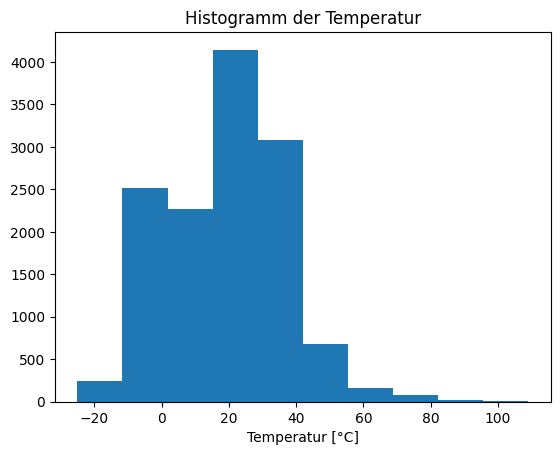

In [10]:
#Die Temperaturwerte werden geplotet um unrealistische Werte zu erkennen
plt.hist(df["Temperature"])

plt.title("Histogramm der Temperatur")
plt.xlabel("Temperatur [°C]")

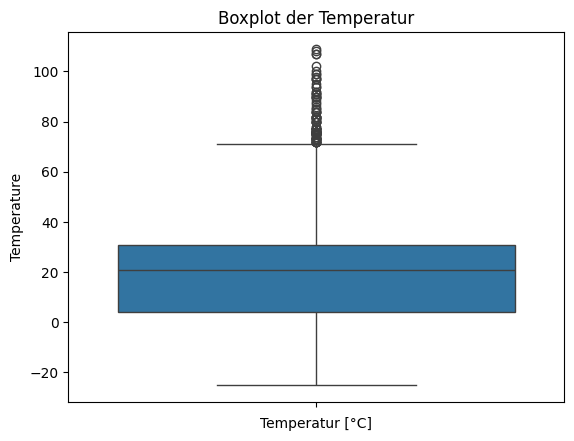

In [11]:
#Alternativ können wir die unrealistischen Werte mit einem Boxplot erkennen

sns.boxplot(df['Temperature'])

plt.title("Boxplot der Temperatur")
plt.xlabel("Temperatur [°C]")

plt.show()

In [12]:
#Mithilfe der Interquartilsabstand (IQR)-Methode werden Ausreißer eleminiert

IQR_temp = df["Temperature"].quantile(0.75) - df["Temperature"].quantile(0.25)
untergrenze_temp = df["Temperature"].quantile(0.25) - (1.5 * IQR_temp)
obergrenze_temp = df["Temperature"].quantile(0.75) + (1.5 * IQR_temp)
print("Temperatur Untergrenze:", untergrenze_temp)
print("Temperatur Obergrenze:", obergrenze_temp)

Temperatur Untergrenze: -36.5
Temperatur Obergrenze: 71.5


In [13]:
#Es werden alle Zeilen die nicht zwischen der Ober- und Untergrenze sind gelöscht
#Die höchste jemals gemessene Temperatur weltweit war 56,7°C im Death Valley in den USA im Juli 2013, daher wird dies als neue Obergrenze verwendet

neu_obergrenze_temp = 56.7
index_temp = df[(df["Temperature"] > neu_obergrenze_temp) | (df["Temperature"] < untergrenze_temp)].index
df=df.drop(index_temp, axis=0).reset_index(drop=True)

Die Maximale Luftfeuchtigkeit ist: 109


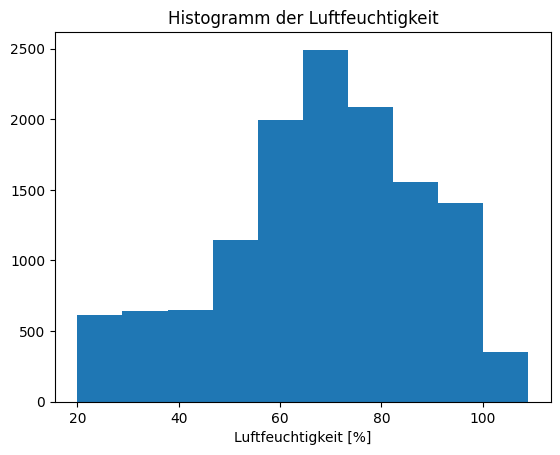

In [14]:
#Die Luftfeuchtigkeit wird geplotet um unrealistische Werte zu erkennen

plt.hist(df["Humidity"])

plt.title("Histogramm der Luftfeuchtigkeit")
plt.xlabel("Luftfeuchtigkeit [%]")

print("Die Maximale Luftfeuchtigkeit ist:",df["Humidity"].max())

In [15]:
# Es werden alle Zeilen die Größer als 100% sind gelöscht

index_hum = df[df.Humidity > 100].index
df = df.drop(index_hum, axis = 0).reset_index(drop=True)

Die Maximale Windgeschwindigkeit ist: 48.5


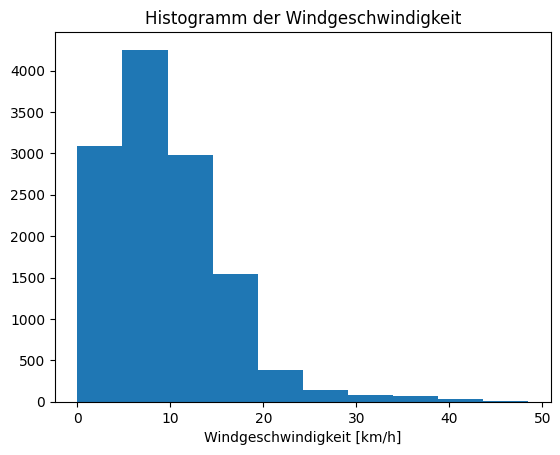

In [16]:
#Die Windgeschwindigkeit wird geplotet um unrealistische Werte zu erkennen
#Hier sind alle Werte im realistischen Bereich

plt.hist(df["Wind Speed"])

plt.title("Histogramm der Windgeschwindigkeit")
plt.xlabel("Windgeschwindigkeit [km/h]")

print("Die Maximale Windgeschwindigkeit ist:",df["Wind Speed"].max())

Die Maximale Niederschlagswahrscheinlichkeit ist: 109.0


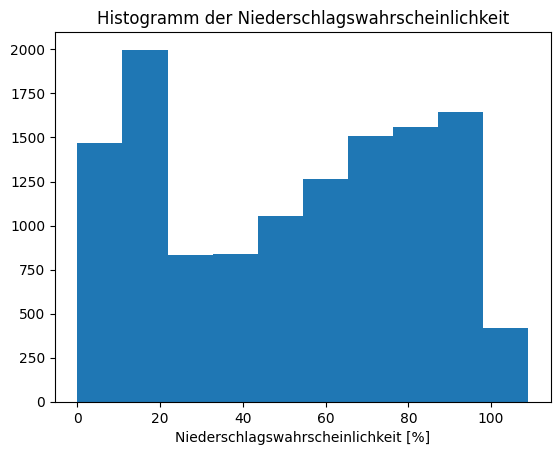

In [17]:
#Die Niederschlagswahrscheinlichkeit wird geplotet um unrealistische Werte zu erkennen

plt.hist(df["Precipitation (%)"])

plt.title("Histogramm der Niederschlagswahrscheinlichkeit")
plt.xlabel("Niederschlagswahrscheinlichkeit [%]")

print("Die Maximale Niederschlagswahrscheinlichkeit ist:",df["Precipitation (%)"].max())

In [18]:
# Es werden alle Zeilen die Größer als 100% sind gelöscht
index_prec = df[df["Precipitation (%)"] >100].index
df = df.drop(index_prec, axis=0).reset_index(drop=True)

Text(0.5, 0, 'Atmosphären Druck [hPa]')

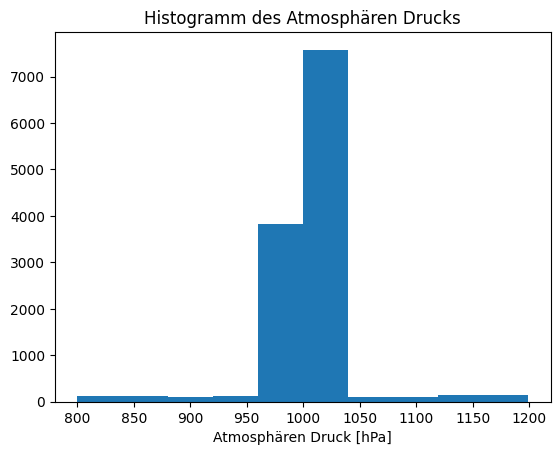

In [19]:
#Der Atmospherische Druck wird geplotet um unrealistische Werte zu erkennen

plt.hist(df["Atmospheric Pressure"])

plt.title("Histogramm des Atmosphären Drucks")
plt.xlabel("Atmosphären Druck [hPa]")

In [20]:
#Mithilfe der Interquartilsabstand (IQR)-Methode werden Ausreißer eleminiert

IQR_atm = df["Atmospheric Pressure"].quantile(0.75) - df["Atmospheric Pressure"].quantile(0.25)
obergrenze_atm = df["Atmospheric Pressure"].quantile(0.75) + (1.5 * IQR_atm)
untergrenze_atm = df["Atmospheric Pressure"].quantile(0.25) - (1.5 * IQR_atm)

print("Obergrenze des athmospherische Druck", obergrenze_atm)
print("Untergrenze des athmospherische Druck", untergrenze_atm)

Obergrenze des athmospherische Druck 1049.99875
Untergrenze des athmospherische Druck 961.3087499999999


In [21]:
index_atm = df[(df["Atmospheric Pressure"] > obergrenze_atm) | (df["Atmospheric Pressure"] < untergrenze_atm)].index
df = df.drop(index_atm, axis=0).reset_index(drop=True)

Text(0.5, 0, 'UV Index [-]')

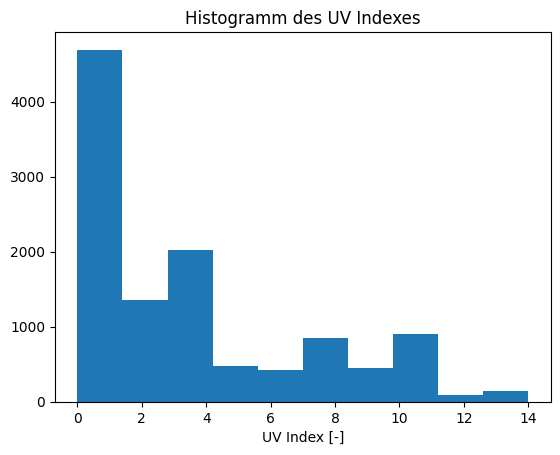

In [22]:
#Der UV Index wird geplotet um unrealistische Werte zu erkennen
plt.hist(df["UV Index"])

plt.title("Histogramm des UV Indexes")
plt.xlabel("UV Index [-]")
#Alle Werte im Realistischen Bereich

Text(0.5, 0, 'Sichtweite [km]')

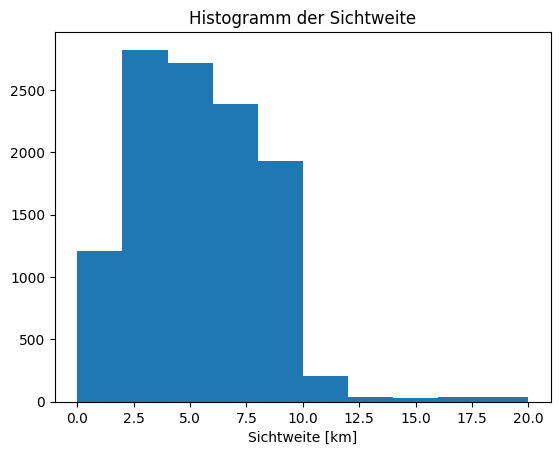

In [23]:
#Der Sichtweite wird geplotet um unrealistische Werte zu erkennen
plt.hist(df["Visibility (km)"])

plt.title("Histogramm der Sichtweite")
plt.xlabel("Sichtweite [km]")

In [24]:
# Um Überlappungen in den verschiedenen Spalte zu kontrollieren, lassen wir uns die möglichen values anzeigen
# In keiner Spalte liegt eine Überlappung der values vor

print("Cloud Cover:", df["Cloud Cover"].unique())
print("Season:", df["Season"].unique())
print("Location:", df["Location"].unique())
print("Weather Type:",df["Weather Type"].unique())

Cloud Cover: ['partly cloudy' 'clear' 'overcast' 'cloudy']
Season: ['Winter' 'Spring' 'Summer' 'Autumn']
Location: ['inland' 'mountain' 'coastal']
Weather Type: ['Rainy' 'Cloudy' 'Sunny' 'Snowy']


## Ersetzen Missing Values

Da alle Ausreiße entfernt wurden, können wir jetzt die Missing values mit der Mittelwerten der jeweiligen Kategorien ersetzen.

In [25]:
# Alle Zeilen finden, die mindestens einen missing value (NaN) enthalten
missing_values = df[df.isnull().any(axis=1)]

# Ausgabe der Zeilen mit missing values
print("Zeilen mit fehlenden Werten (NaN):")
print(missing_values)

Zeilen mit fehlenden Werten (NaN):
      Temperature  Humidity  Wind Speed  Precipitation (%)    Cloud Cover  \
87            NaN        91         9.5               82.0       overcast   
261           NaN        77        13.5               89.0  partly cloudy   
8851          NaN        86        20.0               70.0       overcast   
8852          NaN        61         5.0               10.0       overcast   

      Atmospheric Pressure  UV Index  Season  Visibility (km)  Location  \
87                 1019.42         3  Summer              4.0  mountain   
261                1019.08         2  Summer              4.0    inland   
8851                990.98         4  Summer              2.0    inland   
8852               1012.69         3  Summer              5.5  mountain   

     Weather Type  
87          Rainy  
261         Rainy  
8851        Rainy  
8852       Cloudy  


Da sich in den Kategorienspalten keine Missing Values gefunden wurden, müssen hierbei keine ersetzt werden.

In [26]:
# Automatische Erkennung von numerischen und kategorischen Spalten
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns.tolist()
group_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()
print("Kategorische Spalten:", group_columns)
print("Numerische Spalten:", numeric_columns)

Kategorische Spalten: ['Cloud Cover', 'Season', 'Location', 'Weather Type']
Numerische Spalten: ['Temperature', 'Humidity', 'Wind Speed', 'Precipitation (%)', 'Atmospheric Pressure', 'UV Index', 'Visibility (km)']


In [27]:
#Ersetzen Missing Values
for col in numeric_columns:
    # Durchschnittswerte für die Gruppierung berechnen
    df[col] = df.groupby(group_columns)[col].transform(
        lambda x: x.fillna(x.mean())
    )

# Theoretisches Entferen von Missing values in Kategorienspalten
df = df.dropna(subset=group_columns)

In [28]:
#Anzeigen der Werte welche theoretisch Missing values ersetzen könnten
grouped_means = df.groupby(group_columns)[numeric_columns].mean()

print("Durchschnittswerte pro Kategorienpaar:")
print(grouped_means)

Durchschnittswerte pro Kategorienpaar:
                                            Temperature   Humidity  \
Cloud Cover   Season Location Weather Type                           
clear         Autumn coastal  Sunny           31.949153  50.785311   
                     inland   Sunny           31.651613  45.967742   
                     mountain Sunny           32.352601  47.011561   
              Spring coastal  Sunny           31.694268  50.025478   
                     inland   Sunny           32.361446  45.746988   
...                                                 ...        ...   
partly cloudy Winter inland   Sunny           32.313433  45.626866   
                     mountain Cloudy          22.610390  65.792208   
                              Rainy           22.865672  79.716418   
                              Snowy           -3.131313  79.562290   
                              Sunny           32.529412  47.431373   

                                            Wind S

In [29]:
# Alle Zeilen finden, die mindestens einen missing value (NaN) enthalten
missing_values = df[df.isnull().any(axis=1)]

# Ausgabe der Zeilen mit missing values
print("Zeilen mit fehlenden Werten (NaN):")
print(missing_values)

Zeilen mit fehlenden Werten (NaN):
Empty DataFrame
Columns: [Temperature, Humidity, Wind Speed, Precipitation (%), Cloud Cover, Atmospheric Pressure, UV Index, Season, Visibility (km), Location, Weather Type]
Index: []


# 3. Datensatz Visualisierung

Als Nächstes soll sich ein Überblick über die Daten selbst sowie ihrer Beziehungen untereinander bzw. vo allem zu unserer Zielvariable verschafft werden. Hierfür werden zunächst Dummie-Variablen geschaffen um auch Zusammenhänge zwischen kategorischen und numerischen Variablen besser darstellen zu können. In diesem Abschnitt wird sowohl eine Vollständige Korrelationsmatrix mit exakten Werten angezeigt als auch eine Korrelationsmatrix welche sich ausschließlich  auf die Korrelationen mit unserem Zielwert bezieht.
Anschließend werden 3 Arten von Diagrammen ausgegeben:
Scatterplots für numerische Variablen vs. Temperature, wobei die Farben die Zugehörigkeit zu unterschiedlichen Kategorien darstellen; Histogramme für Dummy-Variablen vs. Temperature & Boxplots für kategoriale Variablen vs. Temperature.
Somit werden alle Beziehungen zu unserer Zielvariablen grafisch dargestellt.

In [30]:
numeric_columns = df._get_numeric_data().columns
print(numeric_columns)
categorical_columns = df.drop(numeric_columns,axis=1).columns
print(categorical_columns)

Index(['Temperature', 'Humidity', 'Wind Speed', 'Precipitation (%)',
       'Atmospheric Pressure', 'UV Index', 'Visibility (km)'],
      dtype='object')
Index(['Cloud Cover', 'Season', 'Location', 'Weather Type'], dtype='object')


In [31]:
#Wiederholung aus Kapitel 2 der Durchschnittswerte der Zielvariablen pro Kategorienkombination
grouped_means = df.groupby(group_columns)[numeric_columns].mean()

print("Durchschnittswerte pro Kategorienkombinationr:")
print(grouped_means)

Durchschnittswerte pro Kategorienkombinationr:
                                            Temperature   Humidity  \
Cloud Cover   Season Location Weather Type                           
clear         Autumn coastal  Sunny           31.949153  50.785311   
                     inland   Sunny           31.651613  45.967742   
                     mountain Sunny           32.352601  47.011561   
              Spring coastal  Sunny           31.694268  50.025478   
                     inland   Sunny           32.361446  45.746988   
...                                                 ...        ...   
partly cloudy Winter inland   Sunny           32.313433  45.626866   
                     mountain Cloudy          22.610390  65.792208   
                              Rainy           22.865672  79.716418   
                              Snowy           -3.131313  79.562290   
                              Sunny           32.529412  47.431373   

                                          

### Korrelationsmatizen

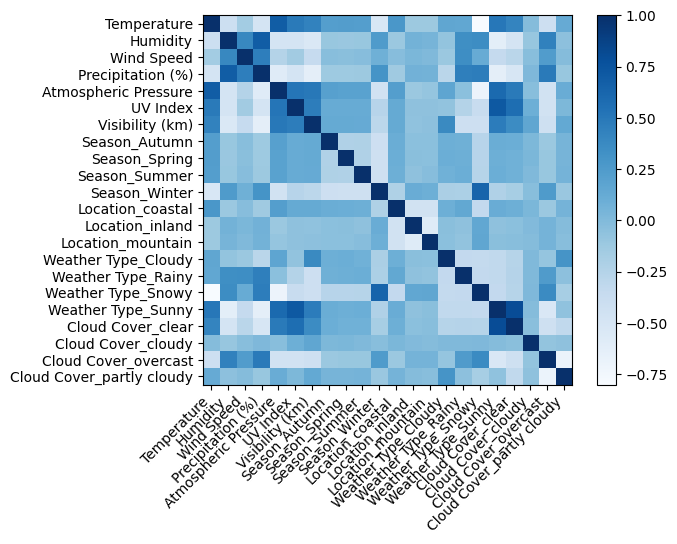

                           Temperature  Humidity  Wind Speed  \
Temperature                   1.000000 -0.410226   -0.160520   
Humidity                     -0.410226  1.000000    0.392143   
Wind Speed                   -0.160520  0.392143    1.000000   
Precipitation (%)            -0.491538  0.685481    0.453652   
Atmospheric Pressure          0.683574 -0.487511   -0.250429   
UV Index                      0.484045 -0.487947   -0.153882   
Visibility (km)               0.427272 -0.548647   -0.356108   
Season_Autumn                 0.222438 -0.105465   -0.030742   
Season_Spring                 0.227101 -0.105848   -0.041767   
Season_Summer                 0.222450 -0.105485   -0.027477   
Season_Winter                -0.526752  0.248314    0.078466   
Location_coastal              0.274762 -0.115006   -0.025414   
Location_inland              -0.125932  0.060007    0.022847   
Location_mountain            -0.124549  0.044849    0.000340   
Weather Type_Cloudy           0.155852 -

In [32]:
# Beispielhafte Umwandlung von kategorischen Variablen in numerische durch One-Hot-Encoding
df_encoded = pd.get_dummies(df[['Season', 'Location', 'Weather Type','Cloud Cover']])

# Füge die numerischen Variablen hinzu
df_numeric = pd.concat([df[['Temperature','Humidity','Wind Speed','Precipitation (%)'
                            ,'Atmospheric Pressure','UV Index','Visibility (km)']],
                        df_encoded], axis=1)

# Korrelationsmatrix berechnen
corr_matrix = df_numeric.corr()

# plotting correlation matrix
plt.imshow(corr_matrix, cmap='Blues')

# adding colorbar
plt.colorbar()

# extracting variable names
variables = []

for i in corr_matrix.columns:

    variables.append(i)

# Adding labels to the matrix
plt.xticks(range(len(corr_matrix)), variables, rotation=45, ha='right')
plt.yticks(range(len(corr_matrix)), variables)

# Display the plot
plt.show()

# Optional: Korrelationen als numerische Werte anzeigen
print(corr_matrix)

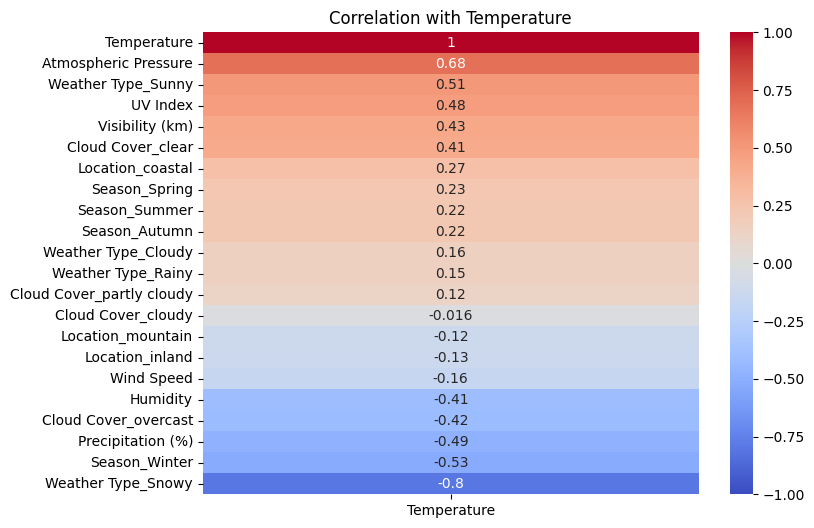

Temperature                  1.000000
Atmospheric Pressure         0.683574
Weather Type_Sunny           0.506860
UV Index                     0.484045
Visibility (km)              0.427272
Cloud Cover_clear            0.409161
Location_coastal             0.274762
Season_Spring                0.227101
Season_Summer                0.222450
Season_Autumn                0.222438
Weather Type_Cloudy          0.155852
Weather Type_Rainy           0.149121
Cloud Cover_partly cloudy    0.120862
Cloud Cover_cloudy          -0.015753
Location_mountain           -0.124549
Location_inland             -0.125932
Wind Speed                  -0.160520
Humidity                    -0.410226
Cloud Cover_overcast        -0.420187
Precipitation (%)           -0.491538
Season_Winter               -0.526752
Weather Type_Snowy          -0.802882
Name: Temperature, dtype: float64


In [33]:
# Korrelationsmatrix nur für die 'Temperature'-Spalte berechnen
corr_with_temperature = df_numeric.corr()['Temperature'].sort_values(ascending=False)

# Korrelationsmatrix plotten
plt.figure(figsize=(8, 6))
sns.heatmap(corr_with_temperature.to_frame(), annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0)
plt.title('Correlation with Temperature')
plt.show()

# Optional: Korrelationen als numerische Werte anzeigen
print(corr_with_temperature)

### Plots

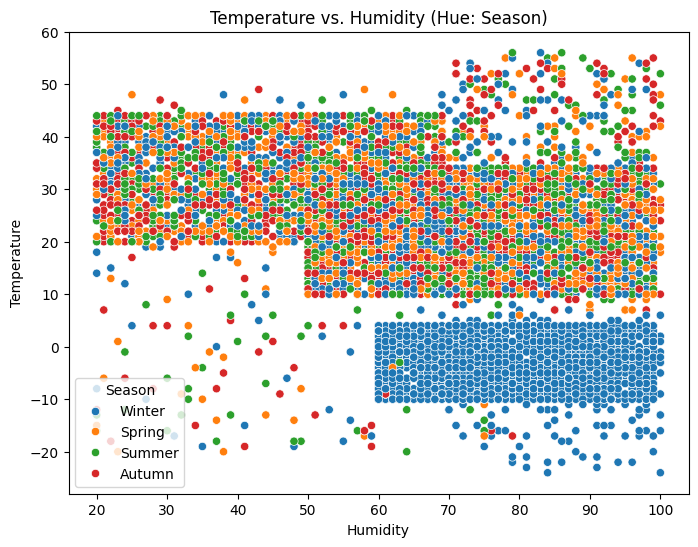

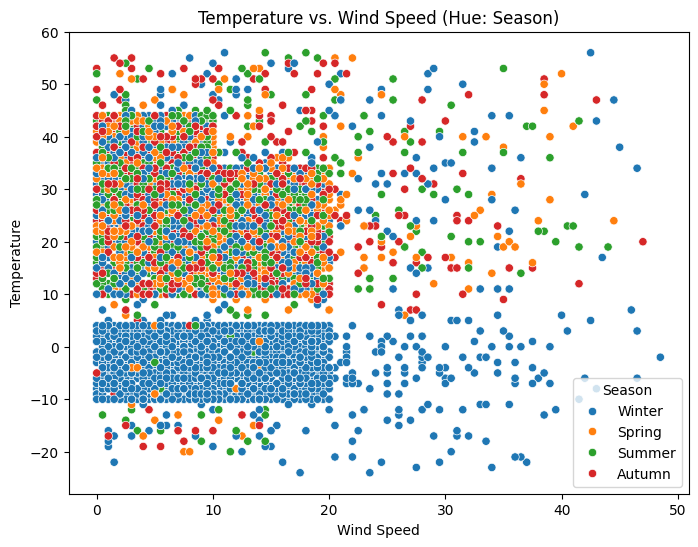

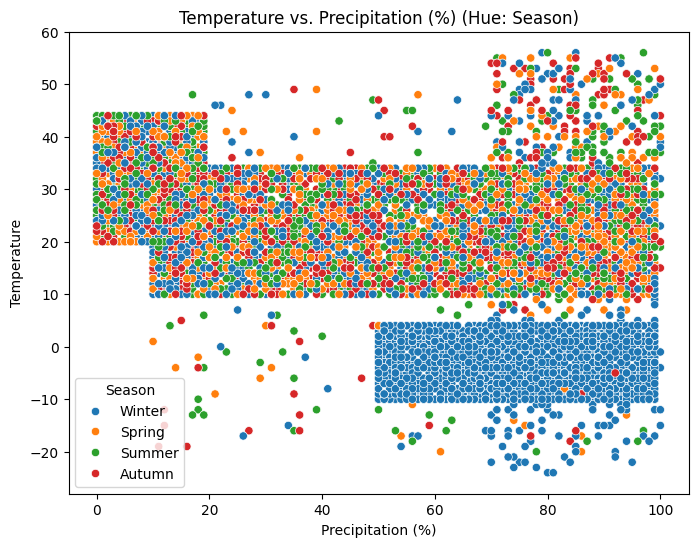

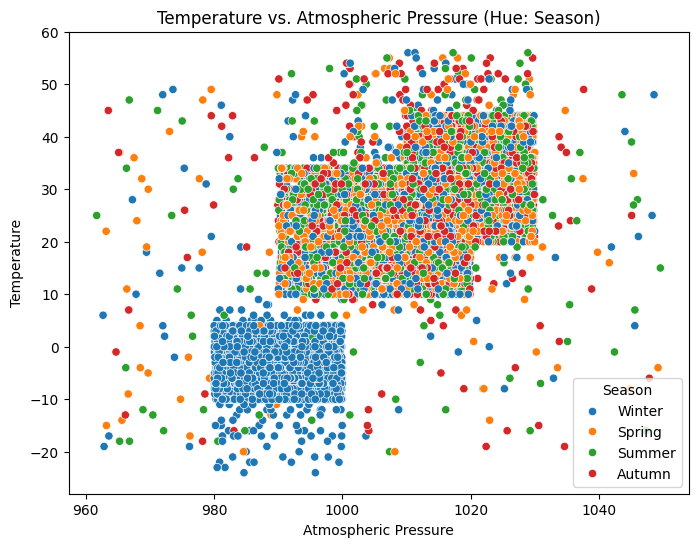

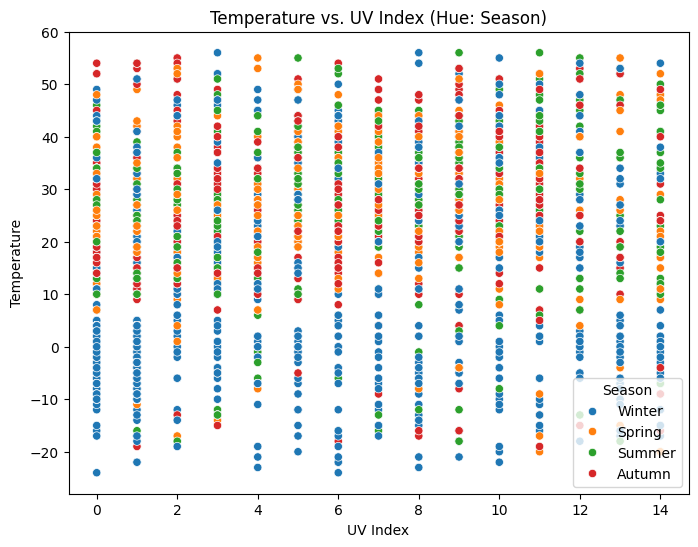

...

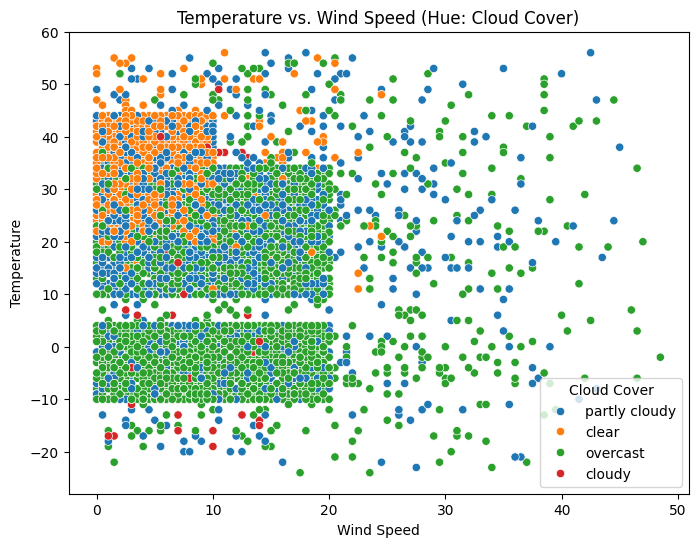

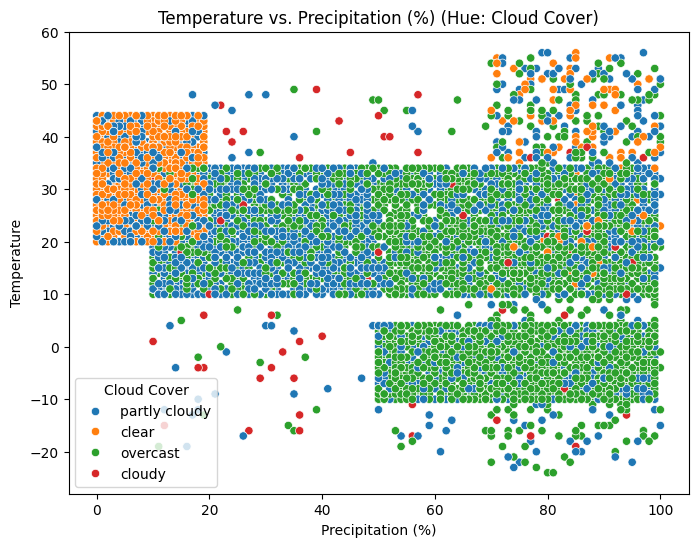

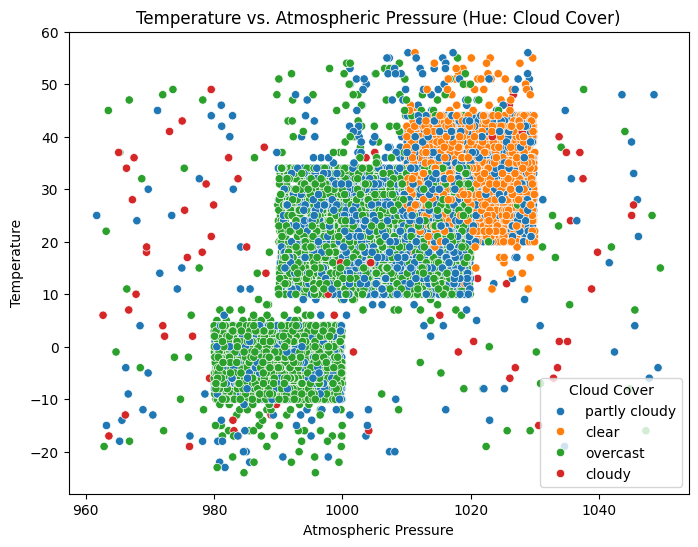

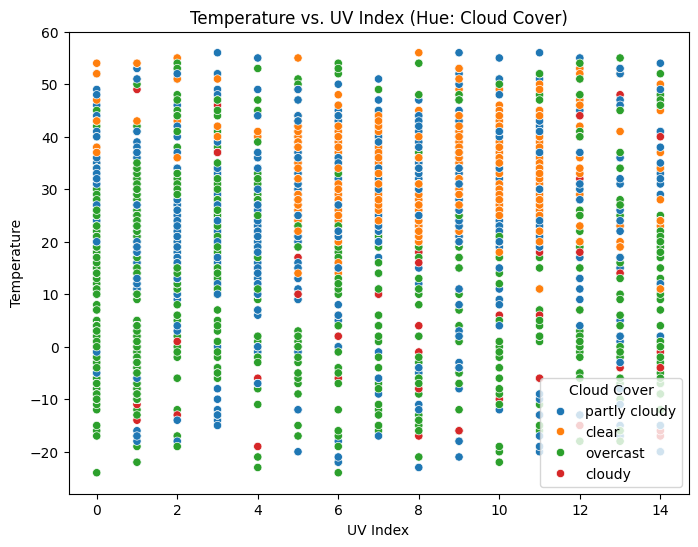

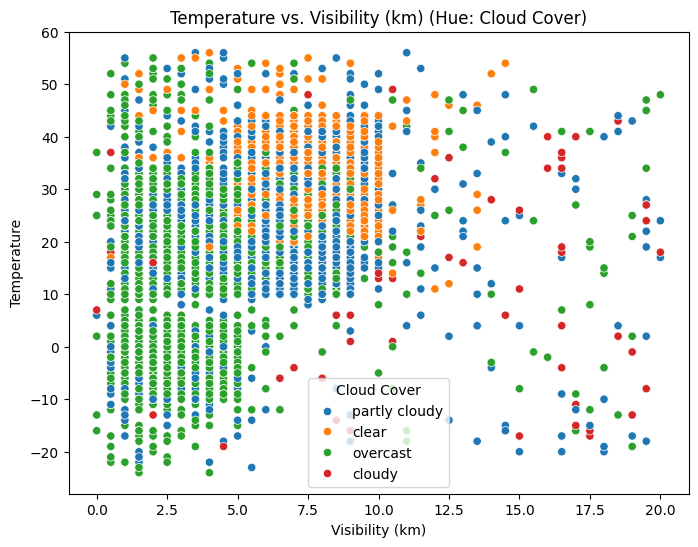

In [34]:
numeric_columns = ['Humidity', 'Wind Speed', 'Precipitation (%)',
                   'Atmospheric Pressure', 'UV Index', 'Visibility (km)']

# Kategorien für die Farbgebung
categorical_columns = ['Season', 'Location', 'Weather Type', 'Cloud Cover']

for cat in categorical_columns:
    for col in numeric_columns:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=df, x=col, y='Temperature', hue=cat)
        plt.title(f'Temperature vs. {col} (Hue: {cat})')
        plt.show()

Es ist oftmals zu erkennen dass der Block an Werten welcher unter ca. 5°C egal bei welchem numerischen Wert oftmals stark abhängig von den Kategorie-Werten ist und nur von höchstens 2 Kategorien, jedoch oft auch sortenrein, gebildet wird

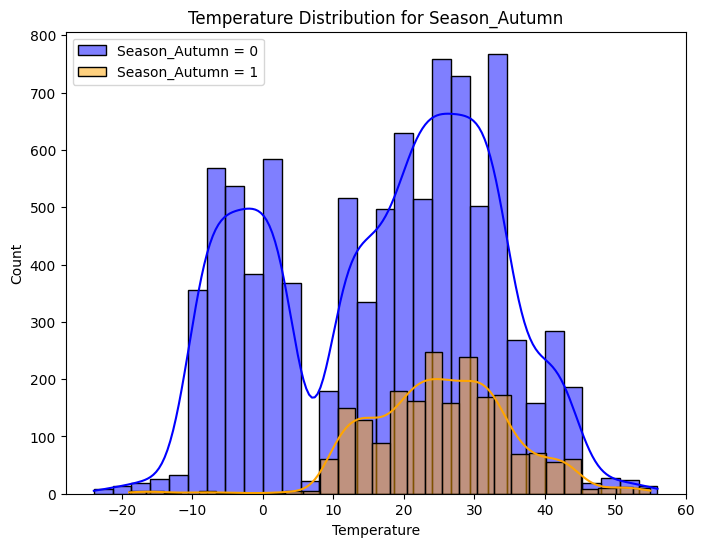

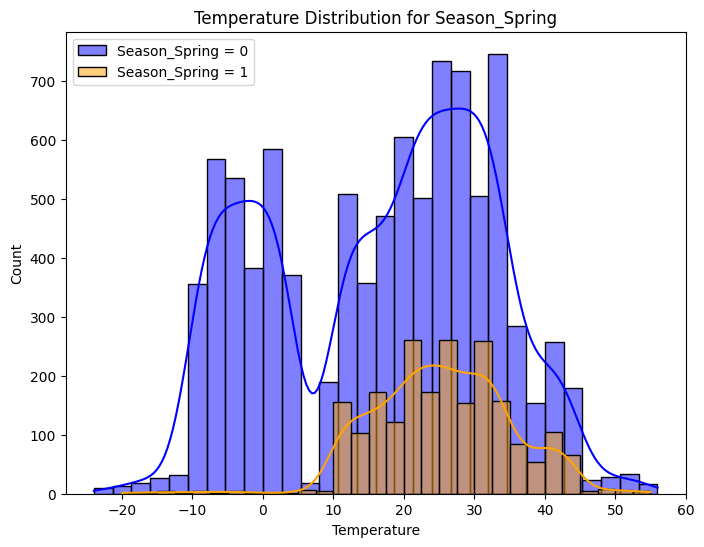

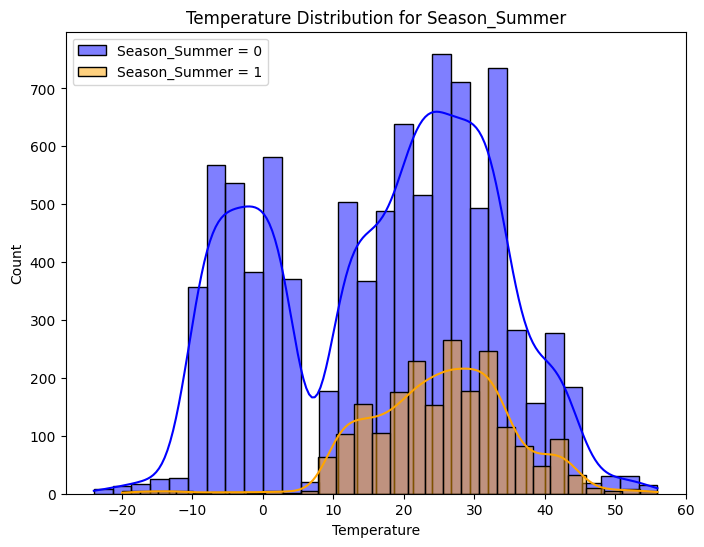

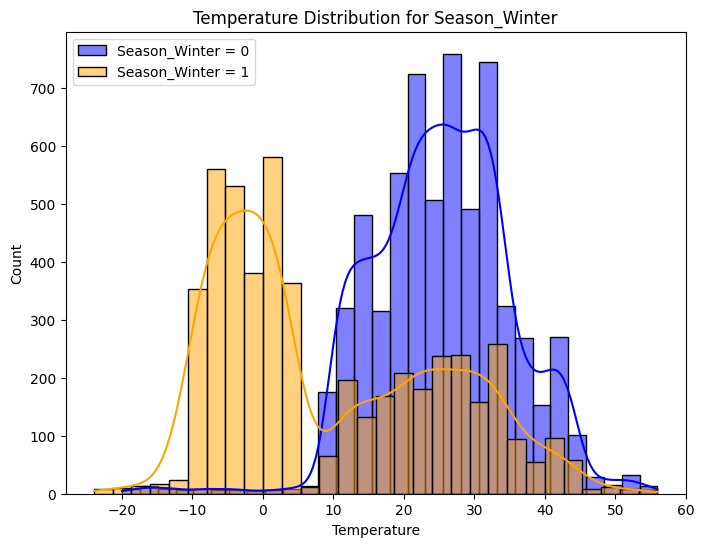

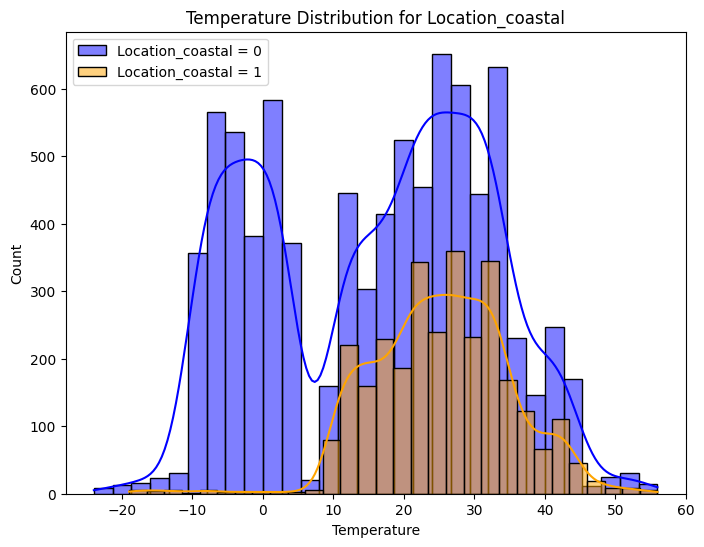

...

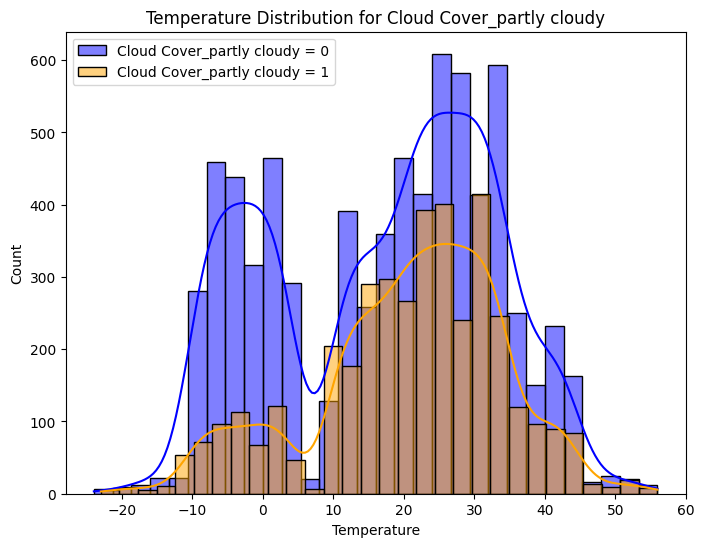

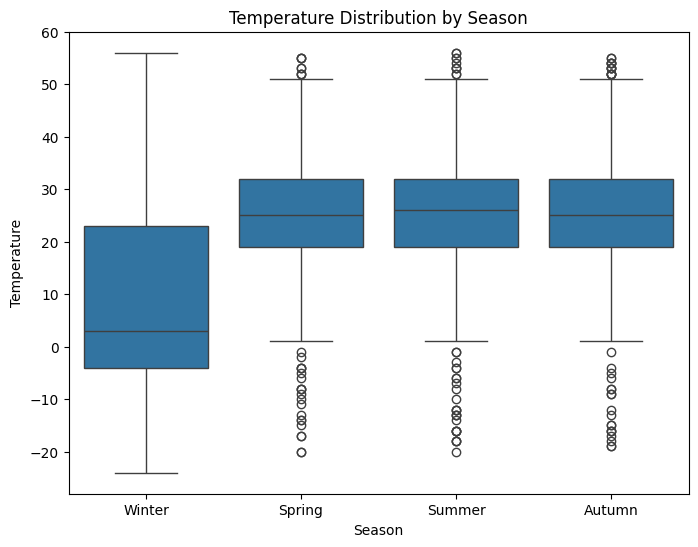

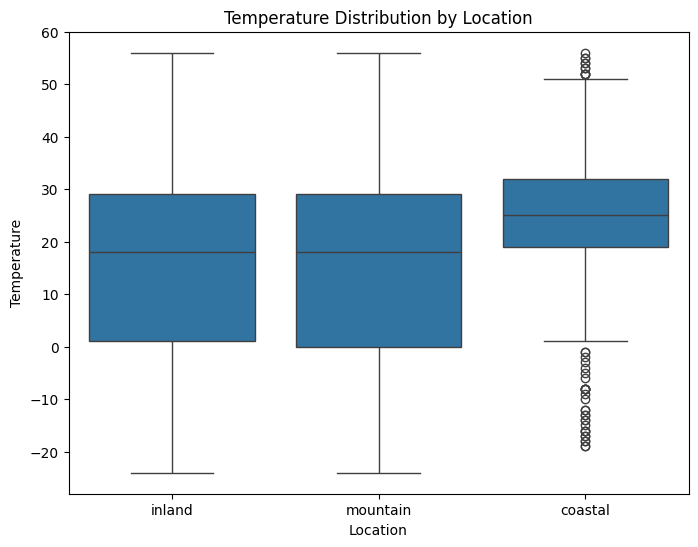

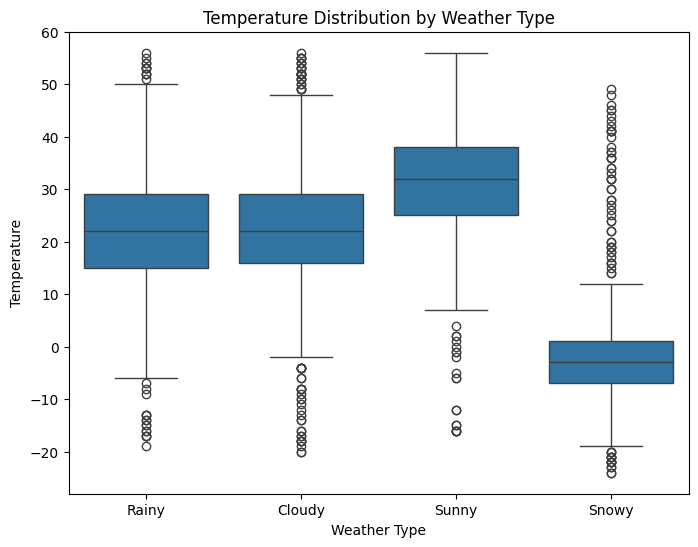

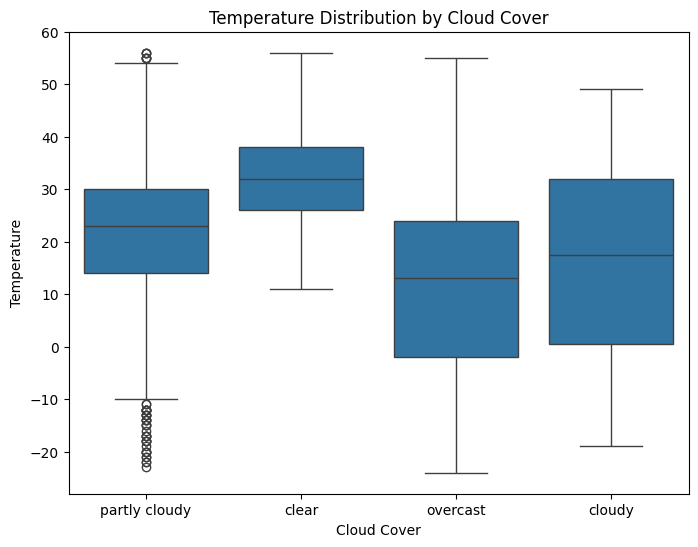

In [35]:

for col in df_numeric:
    if "_" in col:  # Prüfen, ob die Spalte eine Flag ist (Dummy-Variable)
        plt.figure(figsize=(8, 6))
        sns.histplot(data=df_numeric[df_numeric[col] == 0], x='Temperature', kde=True, color='blue', label=f'{col} = 0', bins=30)
        sns.histplot(data=df_numeric[df_numeric[col] == 1], x='Temperature', kde=True, color='orange', label=f'{col} = 1', bins=30)
        plt.title(f'Temperature Distribution for {col}')
        plt.legend()
        plt.show()

# Boxplots für kategoriale Variablen vor One-Hot-Encoding
categorical_columns = ['Season', 'Location', 'Weather Type', 'Cloud Cover']

# Boxplot für jede kategoriale Variable
for col in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=df, x=col, y='Temperature')
    plt.title(f'Temperature Distribution by {col}')
    plt.show()


# 4. Lineare Regression

Um eine möglichst genaue lineare Regression trotz eines eigentlichen Klassifikationsdatensatzes zu geährleisten wurden zwei verschiedene Herangehensweisen ausprobiert. Zunächsteinmal wurde versucht, wie in dem gegebenen Notebook v19 geschaut, ob weitere händische Flags von einzelnen existierenden Flags (siehe Beispiel smoker mit BMI > 30) notwendig ist. Hier wird eine erste Trend-Regressionslinie geplottet. Danach wurden Durchschnittswerte für jede Kombination von numerischer Variable und Kategorie berechnet und geplottet, um zu prüfen, ob eine einfache Durchschnittsbildung oder eine spezifische Modellanpassung (wie das Einfügen von Flags) erforderlich ist.
Anschließend wird durch die Trend-Regressionslienie sowie der Durchscnittslinie entschieden ob eine lineare abhängigkeit vorliegt und wenn ja ob diese beispielsweise quadratisch vorliegt.

## 4.1 Grafische Darstellung zur händischen Flag-Erstellung und Erkennung nichtlinearer Zusammenhänge

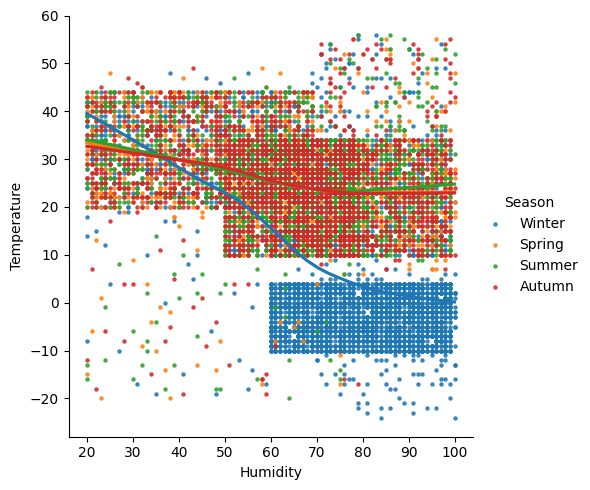

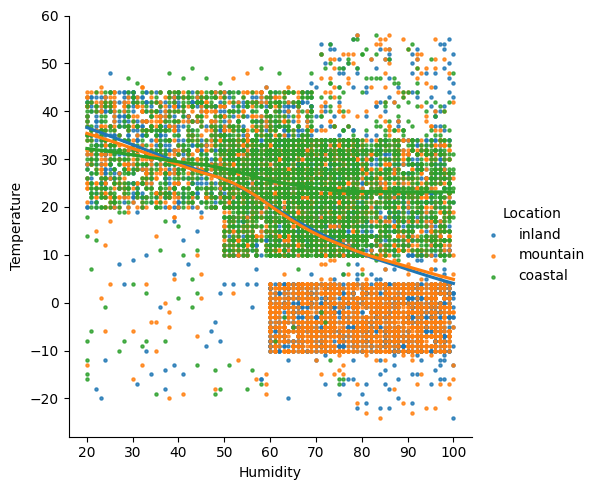

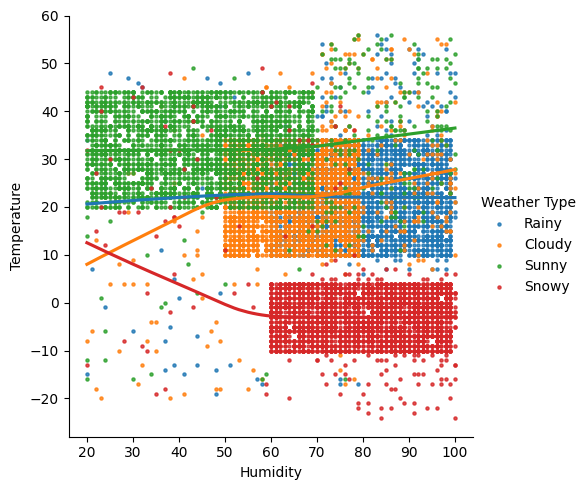

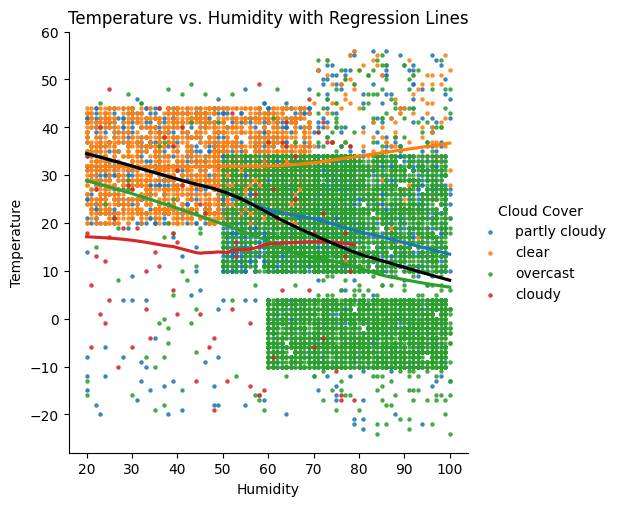

<Figure size 1800x600 with 0 Axes>

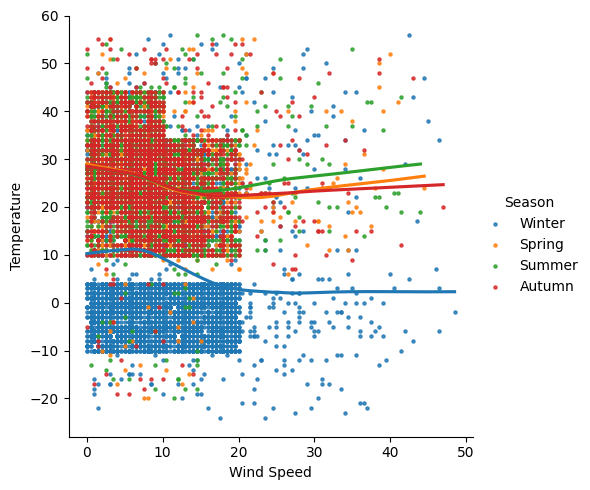

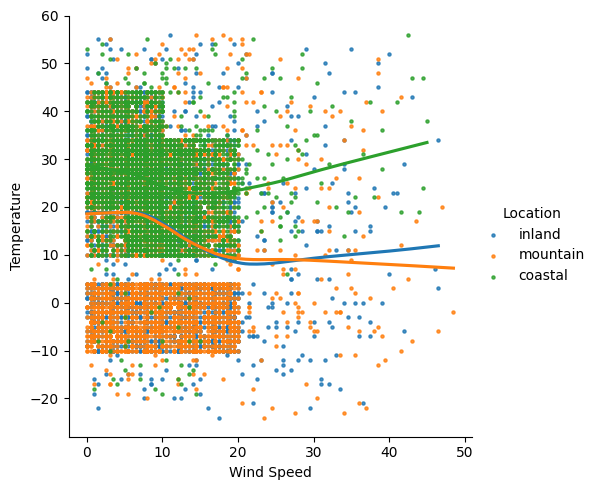

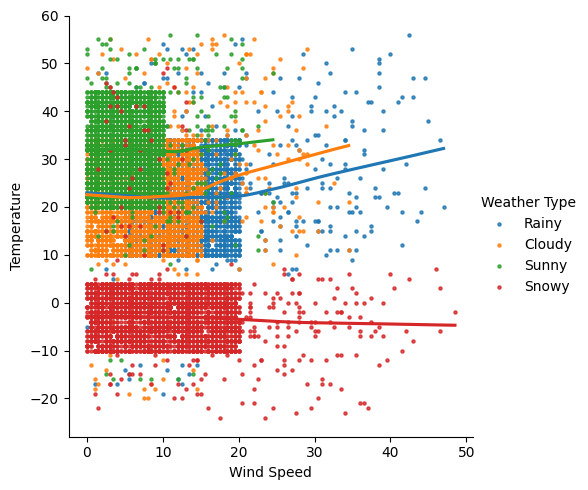

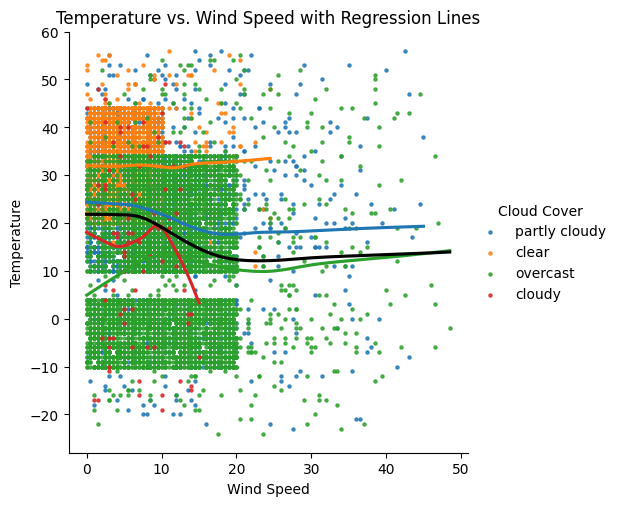

<Figure size 1800x600 with 0 Axes>

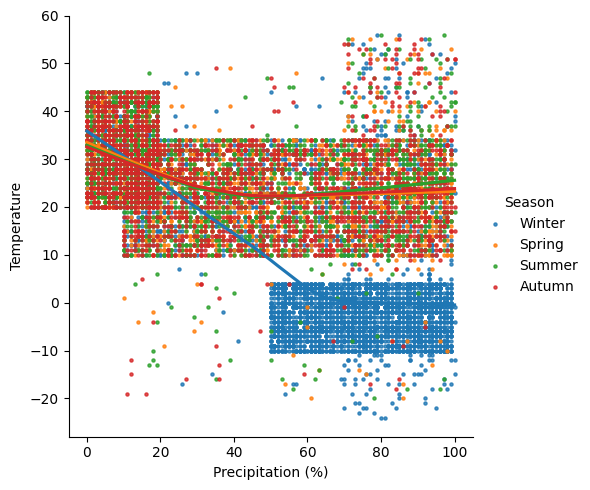

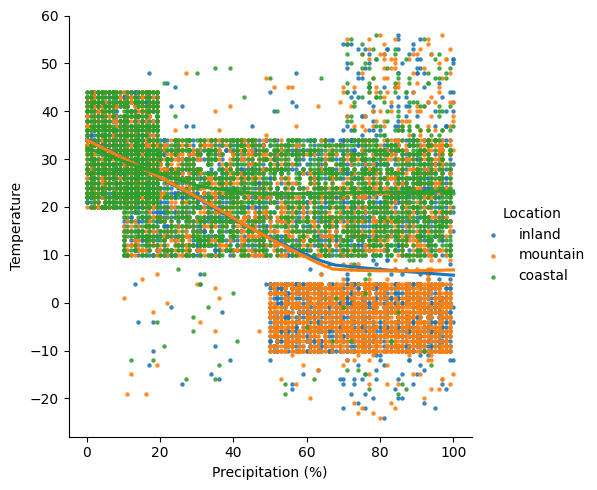

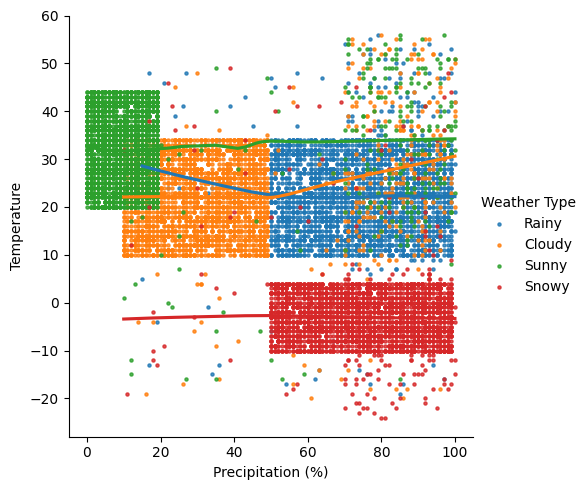

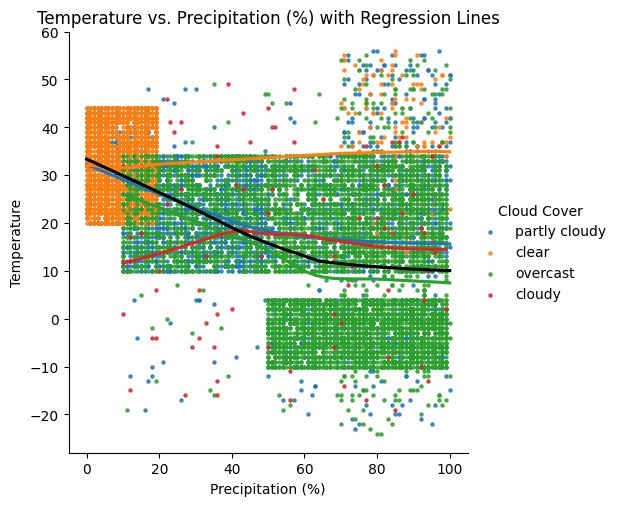

<Figure size 1800x600 with 0 Axes>

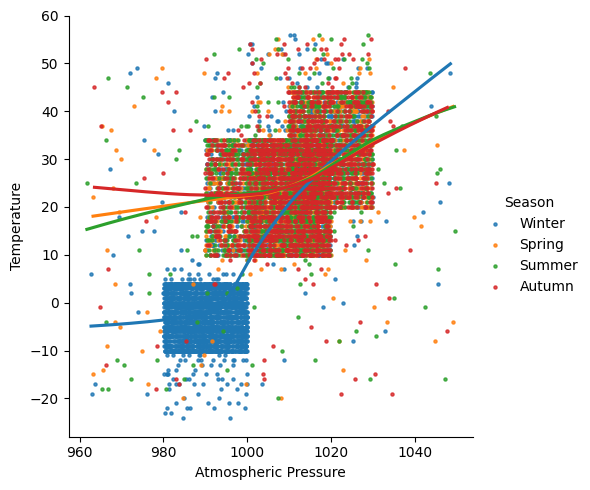

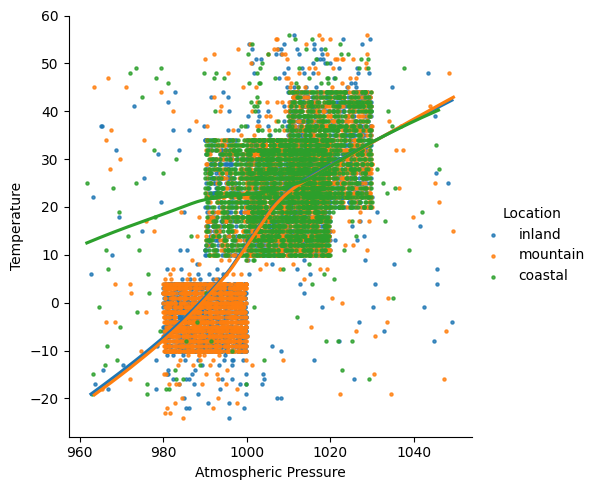

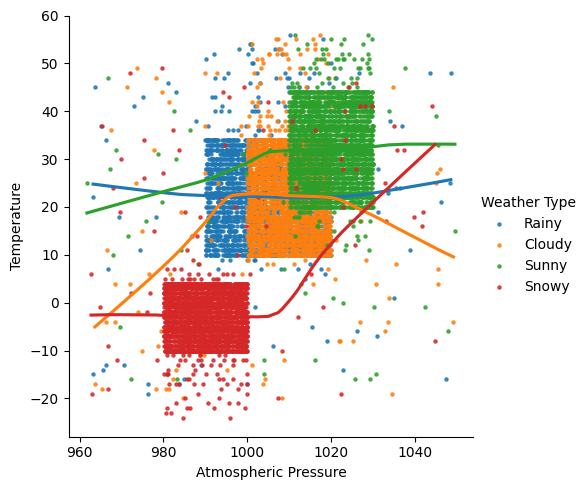

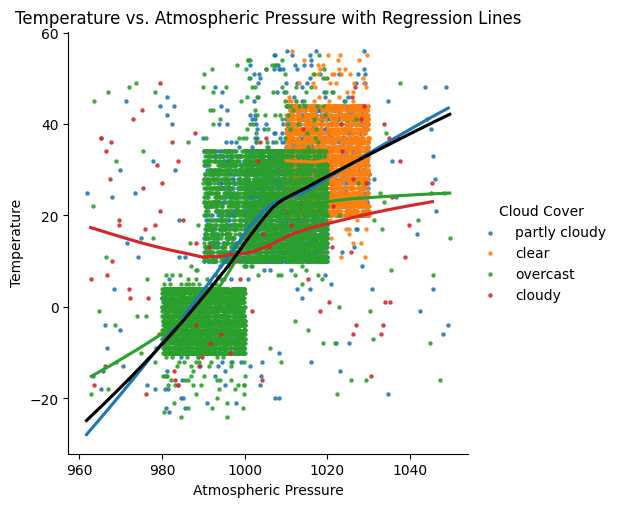

<Figure size 1800x600 with 0 Axes>

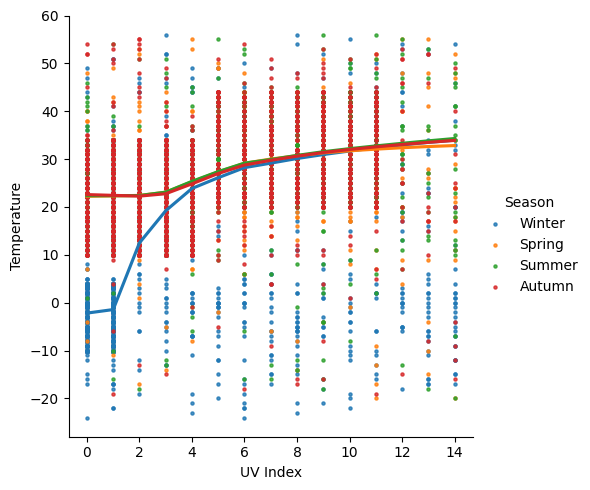

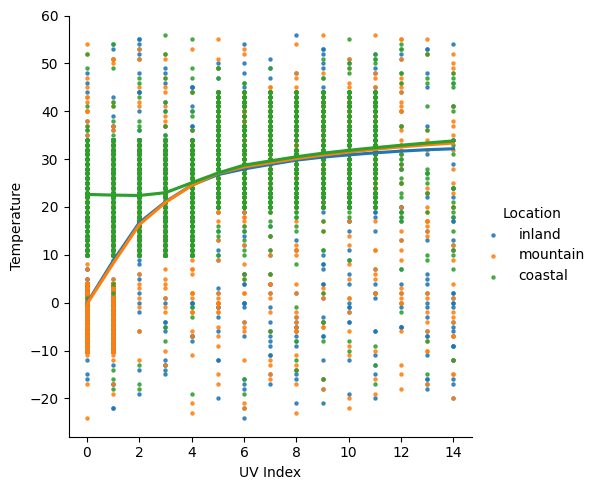

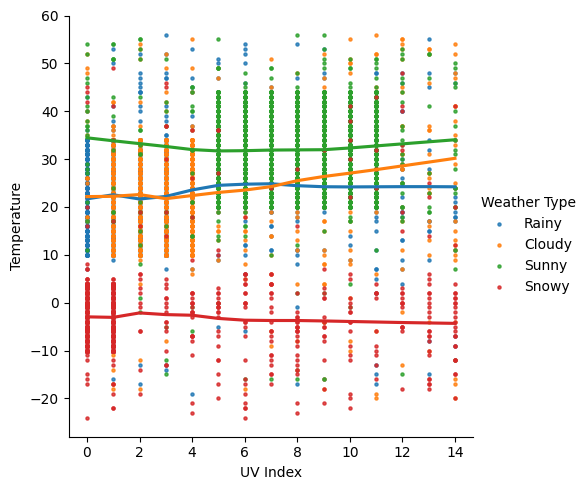

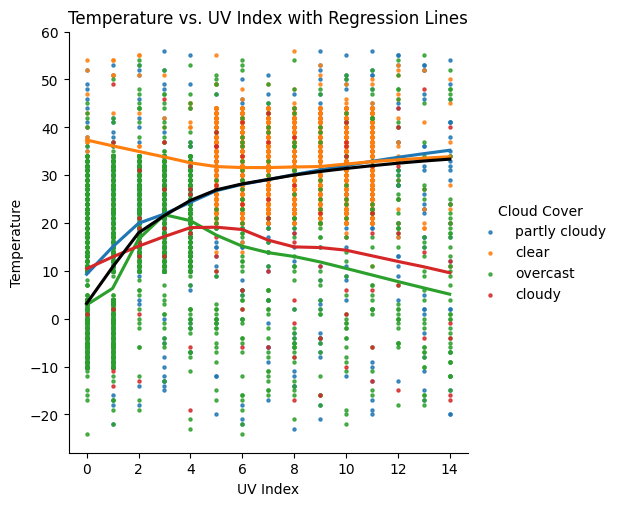

<Figure size 1800x600 with 0 Axes>

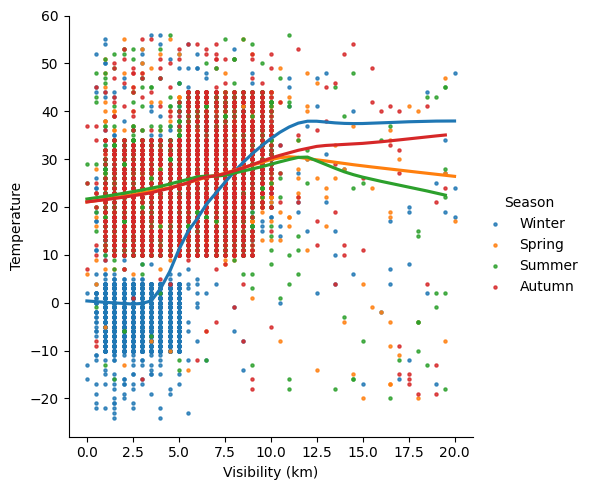

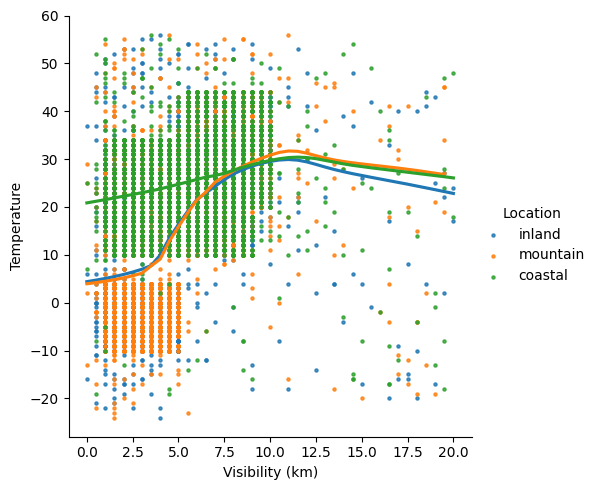

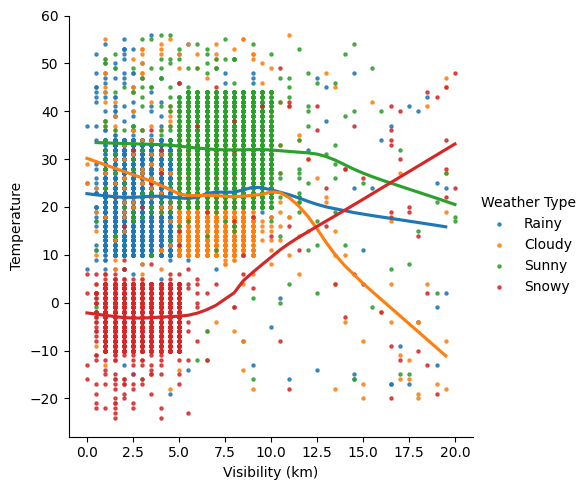

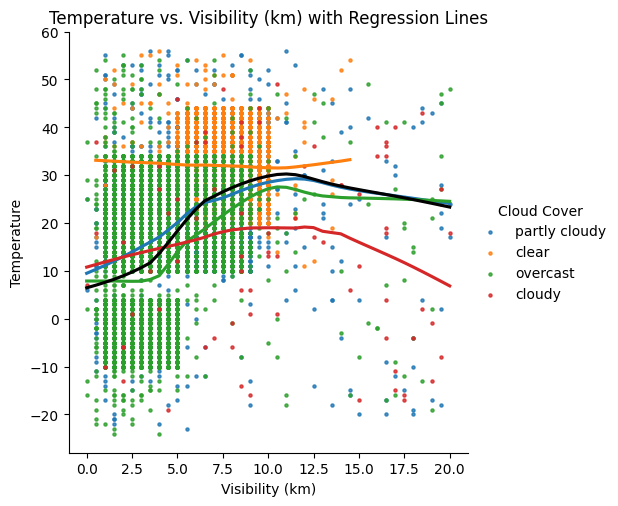

<Figure size 1800x600 with 0 Axes>

In [36]:

# Schleife über jede numerische Variable
for col in numeric_columns:
    

    # Zeichnen der Regressionslinien für jede Kategorie
    for cat in categorical_columns:
        sns.lmplot(data=df, x=col, y='Temperature', hue=cat, fit_reg=True, lowess=True, scatter_kws={'s': 5})
        # Zeichnen der allgemeinen Regressionslinie (in Schwarz)
    sns.regplot(data=df, x=col, y='Temperature', scatter=False, fit_reg=True, lowess=True, line_kws={"color": "black"})
    plt.title(f'Temperature vs. {col} with Regression Lines')
    plt.figure(figsize=(18, 6))
    plt.show()


Aufgrund des in den durch die künstlich erzeugten Werte entstehenden Boxen wurde sich gegen weitere Flags der Kategorien anhand numerischer Werte entschieden. Aufgrund der Homogenität dieser Boxer wäre die Trendlinie pro Flag einzeln betrachtet nun horizontal und würde somit keine lineare Abhängigkeit zeigen. Allerdings zeigt diese Darstellung wie gut der Datensatz auf eine Klassifizierung ausgelegt ist.

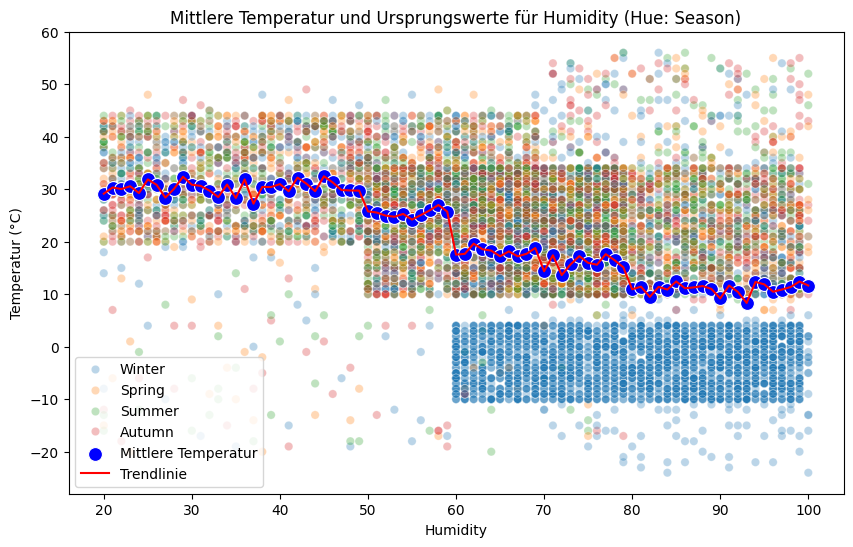

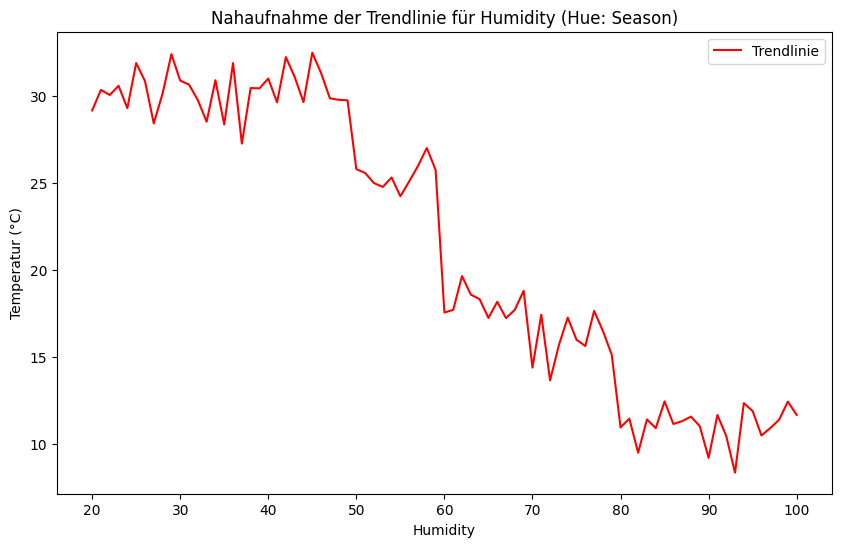

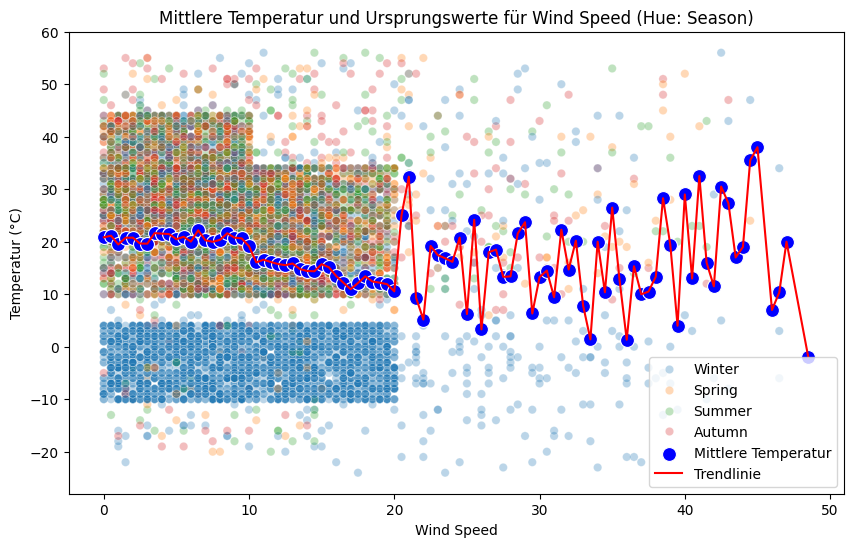

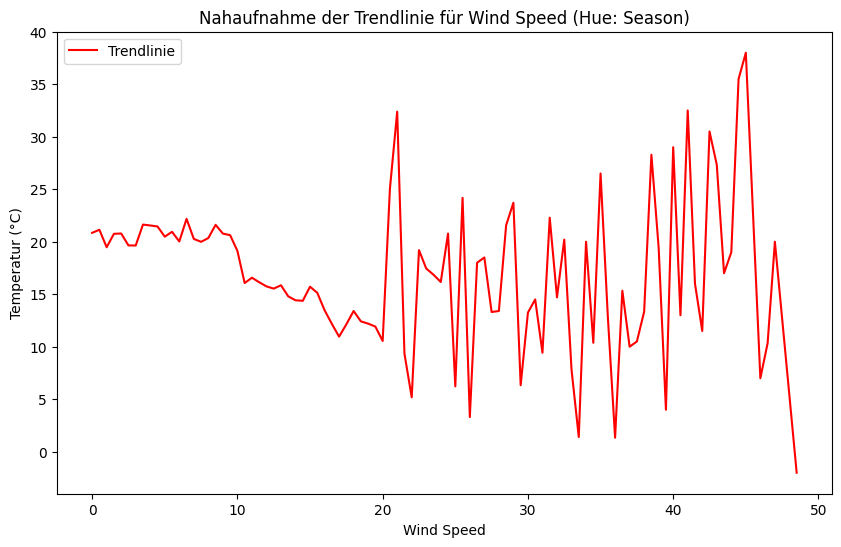

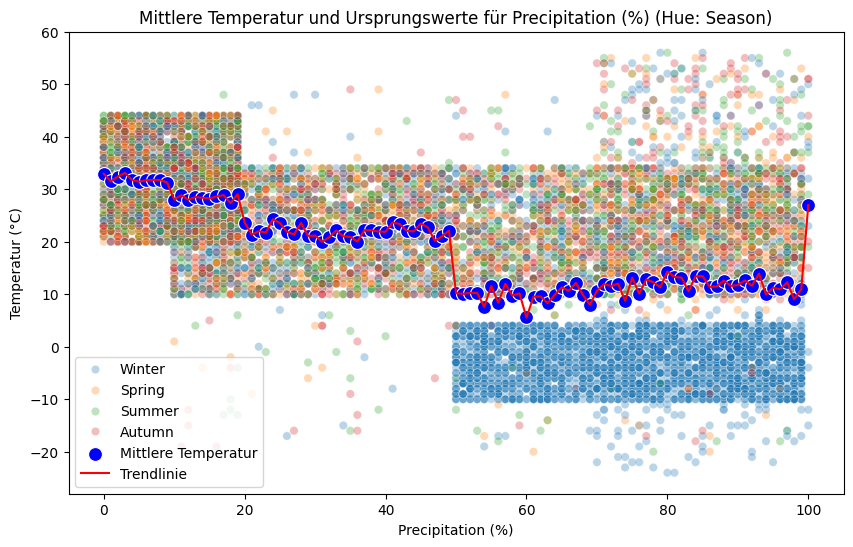

...

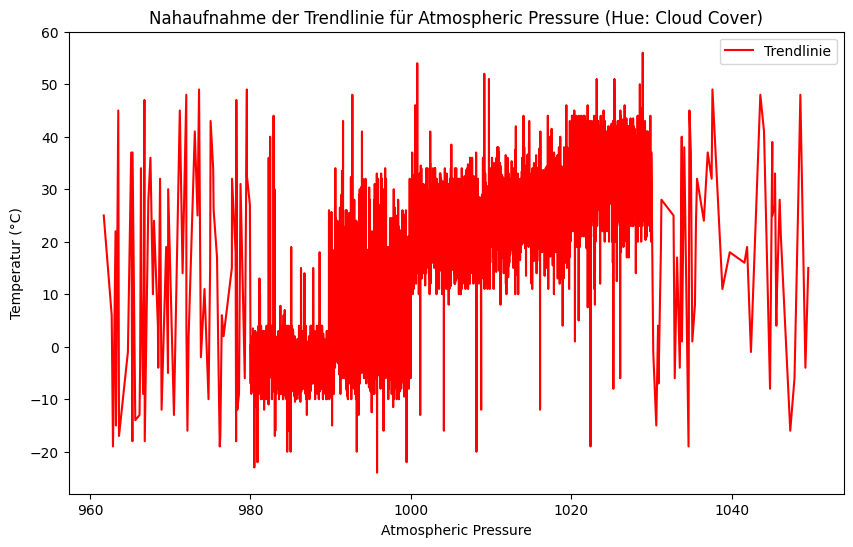

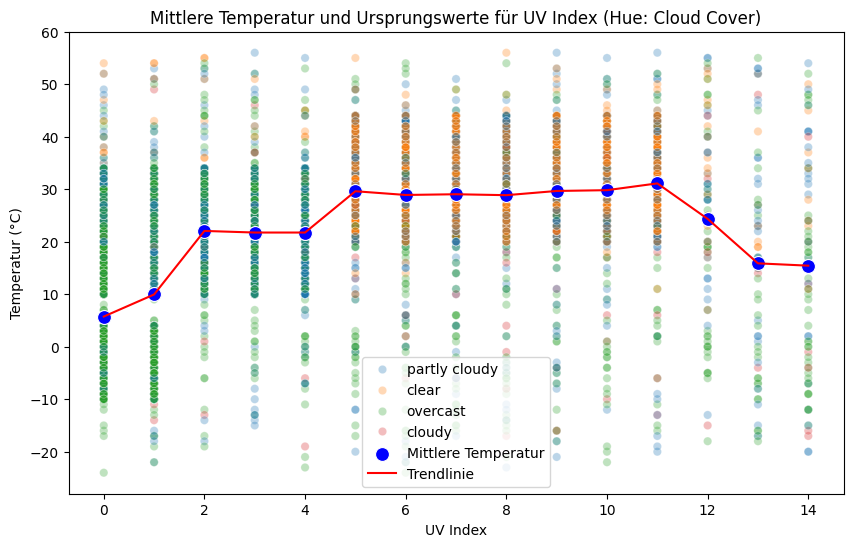

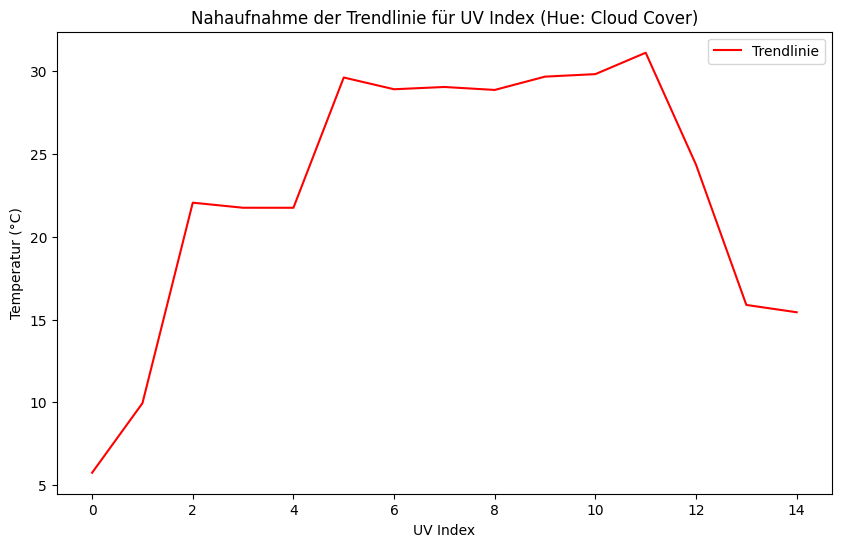

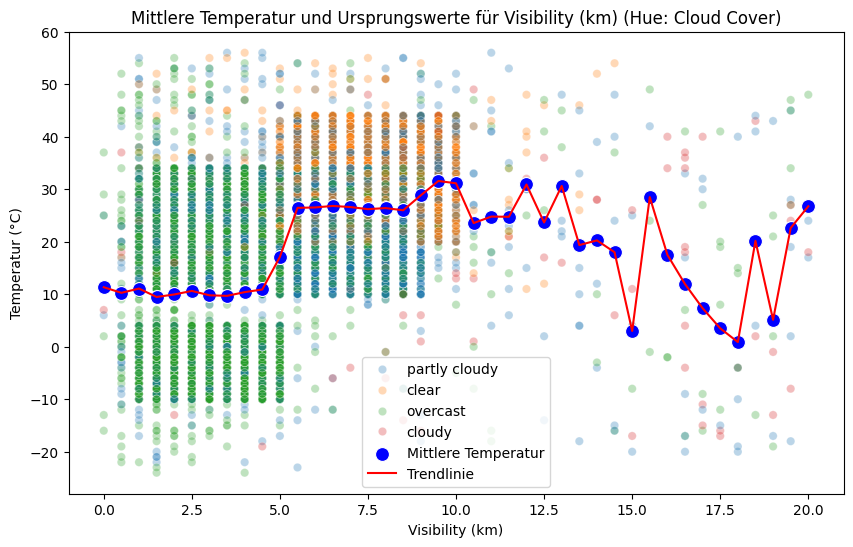

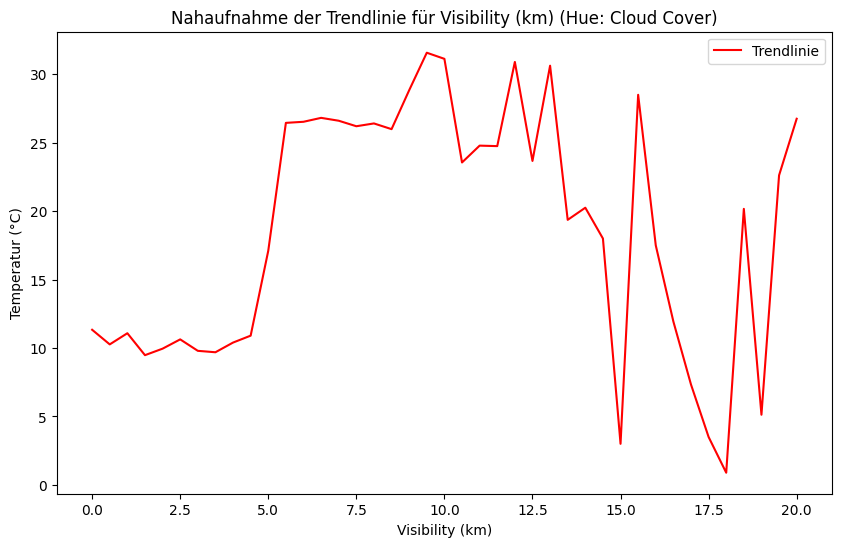

In [37]:
#Verlauf Durchschnittstemperatur je numerischer Variable zur Bildung von händischen Flags oder mathematisch nicht linearer Zusammenhänge

for cat in categorical_columns:
    for col in numeric_columns:
        # Berechne den Mittelwert der Temperatur für jede numerische Spalte und Kategorie
        if col == "Temperature":
            continue
        df_avg_temp = df.groupby(col)['Temperature'].mean().reset_index()
        df_avg_temp[cat] = 'Average'  # Hinzufügen einer Dummy-Spalte, um die Kategorie darzustellen

        # Erstelle die Haupt-Plot-Figur
        plt.figure(figsize=(10, 6))

        # Scatterplot der Ursprungswerte
        sns.scatterplot(data=df, x=col, y='Temperature', hue=cat, alpha=0.3)

        # Scatterplot der mittleren Temperatur pro Kategorie
        sns.scatterplot(data=df_avg_temp, x=col, y='Temperature', color='blue', s=100, marker='o', label='Mittlere Temperatur')

        # Trendlinie der Durchschnittswerte
        sns.lineplot(data=df_avg_temp, x=col, y='Temperature', color='red', label='Trendlinie')

        # Titel und Beschriftungen
        plt.title(f'Mittlere Temperatur und Ursprungswerte für {col} (Hue: {cat})')
        plt.xlabel(col)
        plt.ylabel('Temperatur (°C)')
        plt.legend()
        plt.show()

        # Erstelle die Nahaufnahme ohne die Scatterplot-Punkte
        plt.figure(figsize=(10, 6))

        # Nur die Trendlinie der Durchschnittswerte
        sns.lineplot(data=df_avg_temp, x=col, y='Temperature', color='red', label='Trendlinie')

        # Titel und Beschriftungen für die Nahaufnahme
        plt.title(f'Nahaufnahme der Trendlinie für {col} (Hue: {cat})')
        plt.xlabel(col)
        plt.ylabel('Temperatur (°C)')
        plt.legend()
        plt.show()
  

In [38]:
#Erstellung der händischen Flags
 
df['flag_precip_45_plus'] = np.where(df['Precipitation (%)'] >= 45, 1, 0)

#Beispiele für gestestete aber nicht verwendete Flags da diese das Ergebnis verschlechterten
df['flag_AtP_1005_plus'] = np.where(df['Atmospheric Pressure'] <= 1005, 1, 0)
df['flag_Wind_Speed_20_or_below'] = np.where(df['Wind Speed'] <= 20, 1, 0)
df['flag_Visibility_10_or_below'] = np.where(df['Visibility (km)'] <= 10, 1, 0)

## 4.2 Train-Test-Split

In der nächsten Zelle wird ein Test-Train Split durchgeführt, welcher später auch für die weiteren Modelle verwendet wird

In [39]:
def create_dummies_and_split(data, target_column, test_size=0.2, random_state=42):

    # Zielvariable separieren
    X = data.drop(columns=[target_column])
    y = data[target_column]

    # Kategorische Variablen in Dummy-Variablen konvertieren
    X = pd.get_dummies(X, drop_first=False)

    # Daten in Trainings- und Testdatensätze aufteilen
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)

    return X_train, X_test, y_train, y_test

In [40]:
#Ausführung eines Test-Train Split zur Ausführung der linaren Regression für die Temperatur
X_train_temp, X_test_temp, y_train_temp, y_test_temp = create_dummies_and_split(df, target_column='Temperature')

#print(X_train)

In [41]:
X_train_temp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9127 entries, 4096 to 7270
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Humidity                     9127 non-null   int64  
 1   Wind Speed                   9127 non-null   float64
 2   Precipitation (%)            9127 non-null   float64
 3   Atmospheric Pressure         9127 non-null   float64
 4   UV Index                     9127 non-null   int64  
 5   Visibility (km)              9127 non-null   float64
 6   flag_precip_45_plus          9127 non-null   int32  
 7   flag_AtP_1005_plus           9127 non-null   int32  
 8   flag_Wind_Speed_20_or_below  9127 non-null   int32  
 9   flag_Visibility_10_or_below  9127 non-null   int32  
 10  Cloud Cover_clear            9127 non-null   bool   
 11  Cloud Cover_cloudy           9127 non-null   bool   
 12  Cloud Cover_overcast         9127 non-null   bool   
 13  Cloud Cover_partly c

Da unser Model smf.ols() nicht mit Sonderzeichen oder Leerzeichen in den Spaltennamen arbeiten kann, wurde dies im nächsten Schritt bereinigt.

In [42]:
# Spaltennamen bereinigen
X_train_temp.columns = X_train_temp.columns \
    .str.replace(' ', '_') \
    .str.replace('(', '') \
    .str.replace(')', '') \
    .str.replace('%', '')

# Überprüfen der bereinigten Spaltennamen
X_train_temp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9127 entries, 4096 to 7270
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Humidity                     9127 non-null   int64  
 1   Wind_Speed                   9127 non-null   float64
 2   Precipitation_               9127 non-null   float64
 3   Atmospheric_Pressure         9127 non-null   float64
 4   UV_Index                     9127 non-null   int64  
 5   Visibility_km                9127 non-null   float64
 6   flag_precip_45_plus          9127 non-null   int32  
 7   flag_AtP_1005_plus           9127 non-null   int32  
 8   flag_Wind_Speed_20_or_below  9127 non-null   int32  
 9   flag_Visibility_10_or_below  9127 non-null   int32  
 10  Cloud_Cover_clear            9127 non-null   bool   
 11  Cloud_Cover_cloudy           9127 non-null   bool   
 12  Cloud_Cover_overcast         9127 non-null   bool   
 13  Cloud_Cover_partly_c

In [43]:
# Spaltennamen bereinigen
X_test_temp.columns = X_train_temp.columns \
    .str.replace(' ', '_') \
    .str.replace('(', '') \
    .str.replace(')', '') \
    .str.replace('%', '')

# Überprüfen der bereinigten Spaltennamen
X_test_temp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2282 entries, 6746 to 2954
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Humidity                     2282 non-null   int64  
 1   Wind_Speed                   2282 non-null   float64
 2   Precipitation_               2282 non-null   float64
 3   Atmospheric_Pressure         2282 non-null   float64
 4   UV_Index                     2282 non-null   int64  
 5   Visibility_km                2282 non-null   float64
 6   flag_precip_45_plus          2282 non-null   int32  
 7   flag_AtP_1005_plus           2282 non-null   int32  
 8   flag_Wind_Speed_20_or_below  2282 non-null   int32  
 9   flag_Visibility_10_or_below  2282 non-null   int32  
 10  Cloud_Cover_clear            2282 non-null   bool   
 11  Cloud_Cover_cloudy           2282 non-null   bool   
 12  Cloud_Cover_overcast         2282 non-null   bool   
 13  Cloud_Cover_partly_c

## 4.3 Zwischenversionen um auf bestes Ergebnis zu kommen

In diesem Abschnitt werden alle Zwischenversionen aufgezeigt um von einer Regression mit allen Variablen und Dummyvariablen auf unser besetes Ergebnis zu kommen. Zwischenergebnisse welche das Modell verschlechtert hätten und welche deshalb so nicht übernommen wurden, sind nicht zu finden. Es wurden jeweils noch verschiedene andere Flags sowie das herauslassen von allen einzelnen VAriablen und Dummyvariablen ausprobiert sowie andere mathematischen Zusammenhänge erprobt, welche in die oben durchgeführten Grafiken herausgelesen werden könnten. 

In [44]:
# eine nützliche Funktion, um den Fit eines Modells grafisch zu prüfen!
def plot_compare_model(data, x_var, y_var, y_forecast, n_groups,main=""):
    plt.figure(figsize=(10,6))
    #Kopie der Daten anlegen, weil sonst Original-DataFrame bearbeitet wird
    data_plot = data.copy()
    #group data
    data_plot['xvar_group'] = pd.qcut(data_plot[x_var],q=n_groups,labels=False, duplicates='drop')
    #group observed
    xvar_o = data_plot.groupby('xvar_group')[x_var].mean()
    yvar_o = data_plot.groupby('xvar_group')[y_var].mean()
    # group fitted   
    yvar_f = data_plot.groupby('xvar_group')[y_forecast].mean()
    #plot
    plt.plot(xvar_o, yvar_o,marker='o',label='Observed')
    plt.plot(xvar_o, yvar_f,marker='+',label='Fitted')
    plt.title(main)
    plt.legend()
    plt.grid()
    plt.show()

                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.173
Model:                            OLS   Adj. R-squared:                  0.172
Method:                 Least Squares   F-statistic:                     1903.
Date:                Mon, 26 May 2025   Prob (F-statistic):               0.00
Time:                        12:11:08   Log-Likelihood:                -36927.
No. Observations:                9127   AIC:                         7.386e+04
Df Residuals:                    9125   BIC:                         7.387e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     41.3023      0.548     75.398      0.0

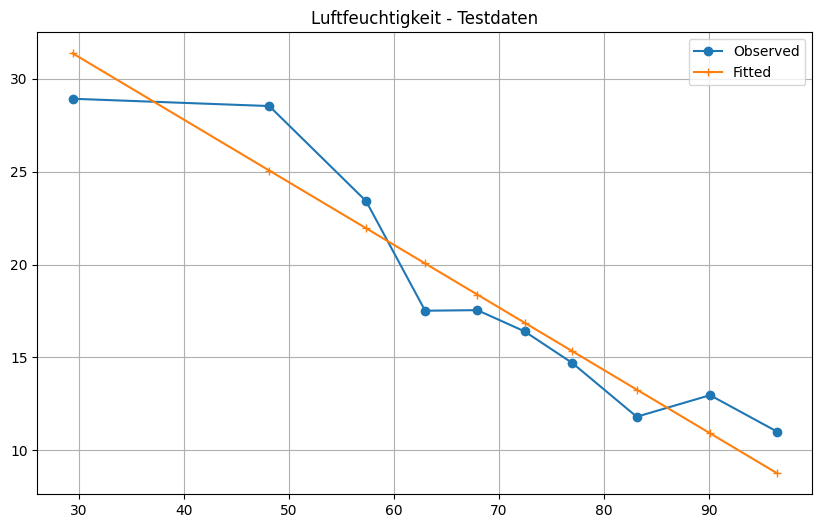

Mean Squared Error (MSE) - Test: 198.7074454694084
R² - Test: 0.1510472040041959
AIC - Model: 73857.36617247041


In [45]:
#Erster Versuch mit einer Variablen zur Erstellung einr Regression

# Einfache lineare Regression: Temperatur als Funktion der Luftfeuchtigkeit
df_train_temp = X_train_temp.copy()
df_train_temp['Temperature'] = y_train_temp

# Modell erstellen
model = smf.ols(formula='Temperature ~ Humidity', data=df_train_temp).fit()

# Zusammenfassung des Modells anzeigen
print(model.summary())
# Residuen berechnen
residuals = model.resid

# MSE berechnen
mse_train = (residuals ** 2).mean()
print(f"Mean Squared Error (MSE) für Trainingsdaten: {mse_train}")

# R² und AIC ausgeben
print(f"R² für Trainingsdaten: {model.rsquared}")
print(f"AIC für Trainingsdaten: {model.aic}")

# Vorhersagen auf den Testdaten
df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp
df_test_temp['fitted'] = model.predict(df_test_temp)

# Funktion für Modell-Vergleich aufrufen (für die Testdaten)
plot_compare_model(df_test_temp, 'Humidity', 'Temperature', 'fitted', 10, "Luftfeuchtigkeit - Testdaten")

# R², MSE und AIC für die Testdaten berechnen
mse_test = ((df_test_temp['Temperature'] - df_test_temp['fitted']) ** 2).mean()
r_squared_test = r2_score(df_test_temp['Temperature'], df_test_temp['fitted'])
aic_test = model.aic  # AIC bleibt vom Modelltrainingsprozess gleich, wird nicht separat für Testdaten berechnet

print(f"Mean Squared Error (MSE) - Test: {mse_test}")
print(f"R² - Test: {r_squared_test}")
print(f"AIC - Model: {aic_test}")


In [46]:
#Ausgangsmodell mit allen VAraible und Dummyvariablen
model = smf.ols(formula='Temperature ~ Humidity + Wind_Speed + Precipitation_ + Atmospheric_Pressure + UV_Index + Visibility_km + Cloud_Cover_clear + Cloud_Cover_cloudy + Cloud_Cover_overcast + Cloud_Cover_partly_cloudy + Season_Spring + Season_Summer	+ Season_Autumn + Season_Winter + Location_inland + Location_coastal + Location_mountain + Weather_Type_Cloudy + Weather_Type_Rainy +	Weather_Type_Snowy + Weather_Type_Sunny', data=df_train_temp).fit()
print(model.summary())
print("\n\nAIC=",model.aic)
# Residuen erneut analysieren
df_train_temp['fitted'] = model.fittedvalues
df_train_temp['residuals'] = model.resid

# Residuen berechnen
residuals = model.resid

# MSE berechnen
mse = (residuals ** 2).mean()
print(f"Mean Squared Error (MSE): {mse}")



                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.714
Model:                            OLS   Adj. R-squared:                  0.714
Method:                 Least Squares   F-statistic:                     1338.
Date:                Mon, 26 May 2025   Prob (F-statistic):               0.00
Time:                        12:11:14   Log-Likelihood:                -32078.
No. Observations:                9127   AIC:                         6.419e+04
Df Residuals:                    9109   BIC:                         6.432e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
Interc

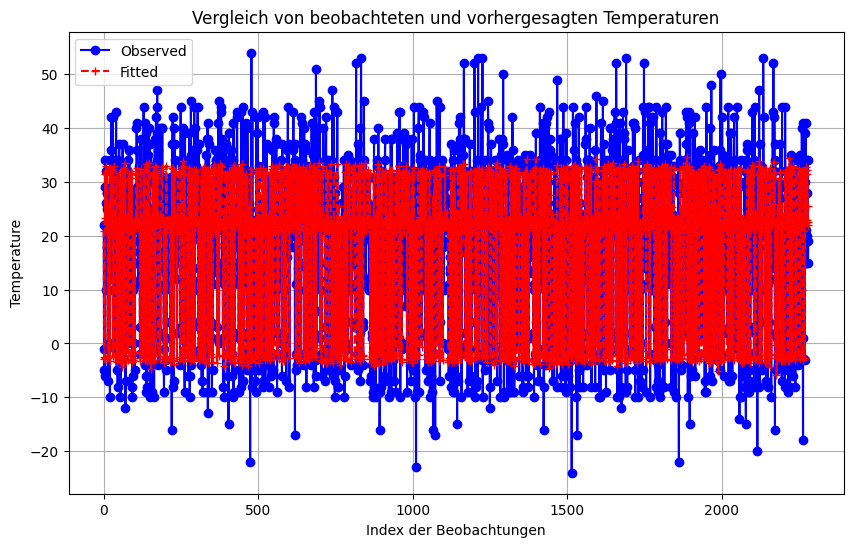

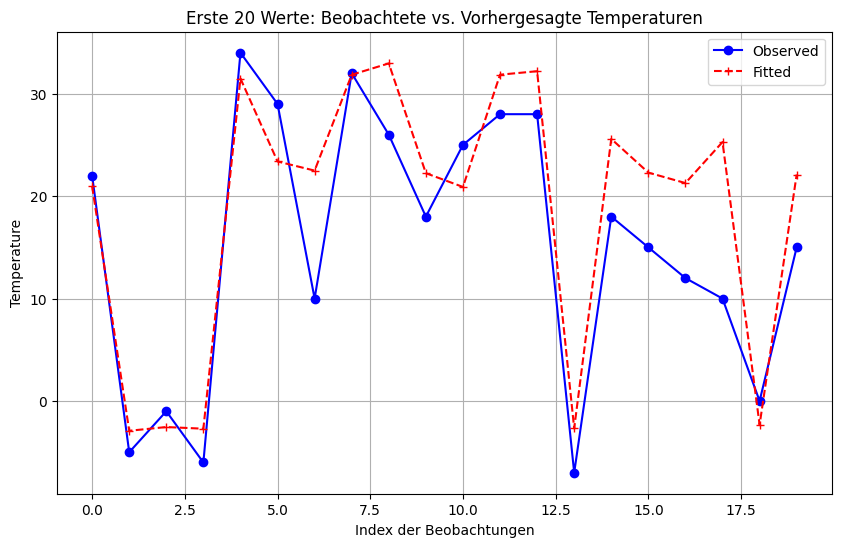

Mean Squared Error (MSE) - Test: 67.88701231332448
R² - Test: 0.7099612006029681
AIC - Model: 64191.979641154445


In [47]:
#Funktion zur Dastellung der mit der Regression errechneten Werte und den wirklichen Werten

def plot_compare_model_complete(data, y_var, y_forecast, main=""):
    plt.figure(figsize=(10, 6))
    
    # Plot der beobachteten Werte
    plt.plot(data[y_var].values, label='Observed', marker='o', linestyle='-', color='blue')
    
    # Plot der vorhergesagten Werte
    plt.plot(data[y_forecast].values, label='Fitted', marker='+', linestyle='--', color='red')
    
    # Plot-Einstellungen
    plt.title(main)
    plt.xlabel('Index der Beobachtungen')
    plt.ylabel(y_var)
    plt.legend()
    plt.grid(True)
    plt.show()

df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp
df_test_temp['fitted'] = model.predict(df_test_temp)

# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted', main="Vergleich von beobachteten und vorhergesagten Temperaturen")

# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")

# R², MSE und AIC für die Testdaten berechnen
mse_test = ((df_test_temp['Temperature'] - df_test_temp['fitted']) ** 2).mean()
r_squared_test = r2_score(df_test_temp['Temperature'], df_test_temp['fitted'])
aic_test = model.aic  # AIC bleibt vom Modelltrainingsprozess gleich, wird nicht separat für Testdaten berechnet

print(f"Mean Squared Error (MSE) - Test: {mse_test}")
print(f"R² - Test: {r_squared_test}")
print(f"AIC - Model: {aic_test}")

                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.714
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     1264.
Date:                Mon, 26 May 2025   Prob (F-statistic):               0.00
Time:                        12:11:22   Log-Likelihood:                -32078.
No. Observations:                9127   AIC:                         6.419e+04
Df Residuals:                    9108   BIC:                         6.433e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
Interc

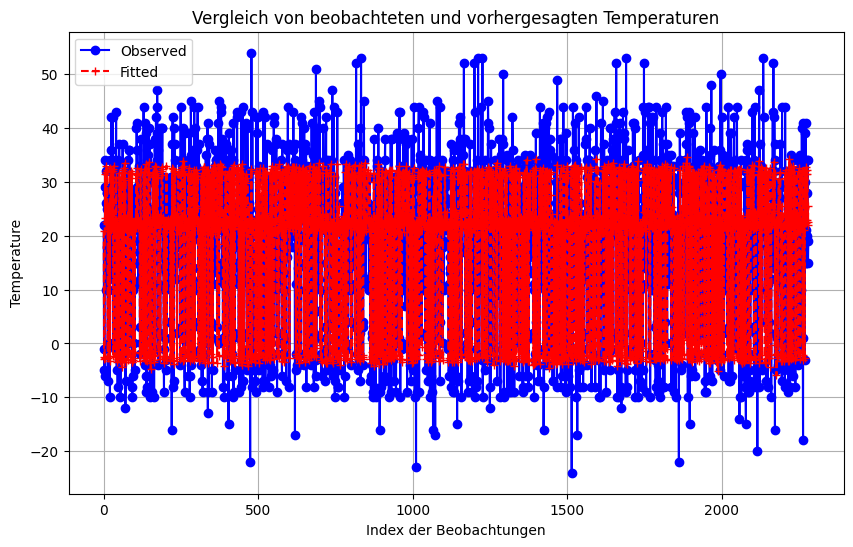

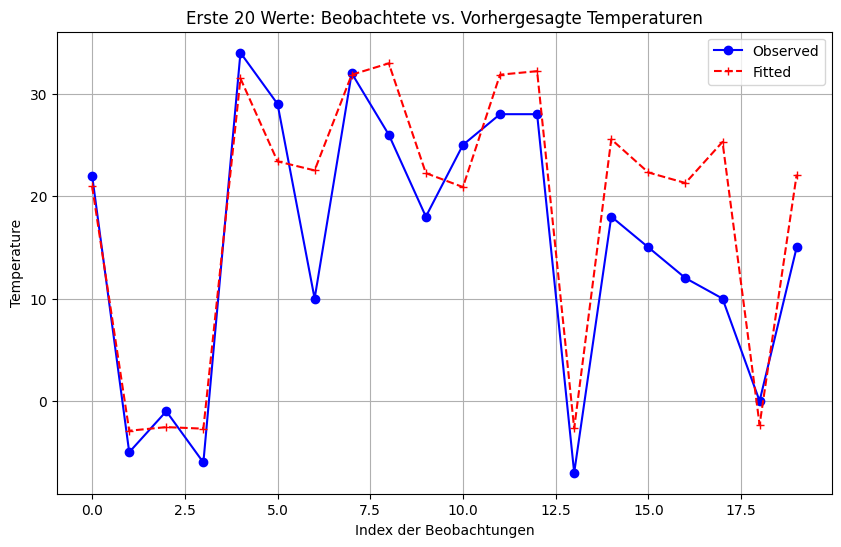

Mean Squared Error (MSE) - Test: 67.88513087437065
R² - Test: 0.7099692388164158
AIC - Model: 64193.96862591473


In [48]:
# 1. UV-Index Quadrieren
model = smf.ols(formula='Temperature ~ Humidity + Wind_Speed + Precipitation_ + Atmospheric_Pressure + UV_Index + I(UV_Index ** 2) + Visibility_km + Cloud_Cover_clear + Cloud_Cover_cloudy + Cloud_Cover_overcast + Cloud_Cover_partly_cloudy + Season_Spring + Season_Summer	+ Season_Autumn + Season_Winter + Location_inland + Location_coastal + Location_mountain + Weather_Type_Cloudy + Weather_Type_Rainy +	Weather_Type_Snowy + Weather_Type_Sunny', data=df_train_temp).fit()
print(model.summary())
print("\n\nAIC=",model.aic)
# Residuen erneut analysieren
df_train_temp['fitted'] = model.fittedvalues
df_train_temp['residuals'] = model.resid

# Residuen berechnen
residuals = model.resid

# MSE berechnen
mse = (residuals ** 2).mean()
print(f"Mean Squared Error (MSE): {mse}")

df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp
df_test_temp['fitted'] = model.predict(df_test_temp)

# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted', main="Vergleich von beobachteten und vorhergesagten Temperaturen")

# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")

# R², MSE und AIC für die Testdaten berechnen
mse_test = ((df_test_temp['Temperature'] - df_test_temp['fitted']) ** 2).mean()
r_squared_test = r2_score(df_test_temp['Temperature'], df_test_temp['fitted'])
aic_test = model.aic  # AIC bleibt vom Modelltrainingsprozess gleich, wird nicht separat für Testdaten berechnet

print(f"Mean Squared Error (MSE) - Test: {mse_test}")
print(f"R² - Test: {r_squared_test}")
print(f"AIC - Model: {aic_test}")

                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.714
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     1263.
Date:                Mon, 26 May 2025   Prob (F-statistic):               0.00
Time:                        12:11:28   Log-Likelihood:                -32078.
No. Observations:                9127   AIC:                         6.419e+04
Df Residuals:                    9108   BIC:                         6.433e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
Inte

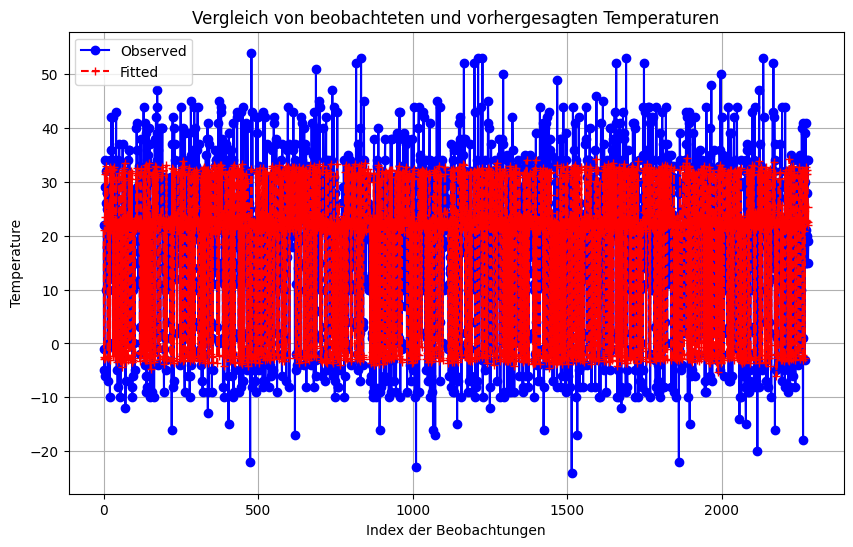

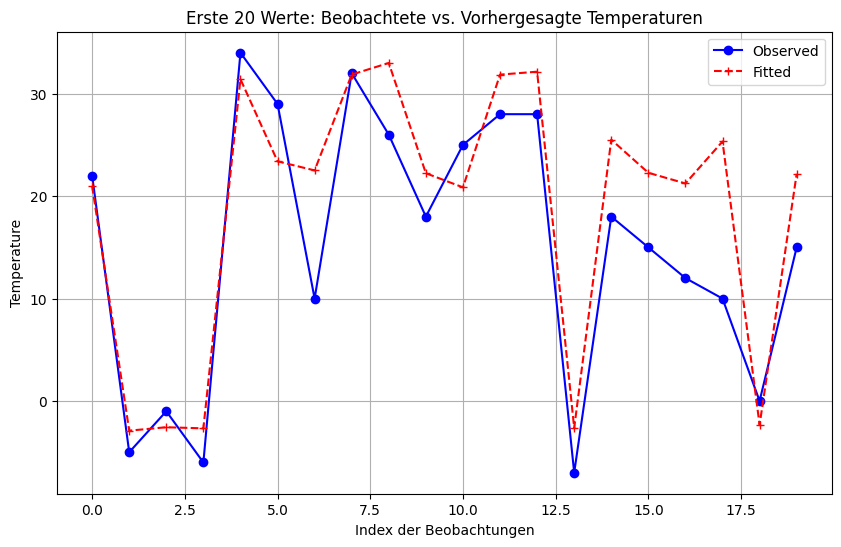

Mean Squared Error (MSE) - Test: 67.87231994181126
R² - Test: 0.7100239719291581
AIC - Model: 64194.32791560294


In [49]:
#2. flag_precip_45_plus:Precipitation_
model = smf.ols(formula='Temperature ~ Humidity + Wind_Speed + flag_precip_45_plus:Precipitation_ + Atmospheric_Pressure + UV_Index + I(UV_Index ** 2) + Visibility_km + Cloud_Cover_clear + Cloud_Cover_cloudy + Cloud_Cover_overcast + Cloud_Cover_partly_cloudy + Season_Spring + Season_Summer	+ Season_Autumn + Season_Winter + Location_inland + Location_coastal + Location_mountain + Weather_Type_Cloudy + Weather_Type_Rainy +	Weather_Type_Snowy + Weather_Type_Sunny', data=df_train_temp).fit()
print(model.summary())
print("\n\nAIC=",model.aic)
# Residuen erneut analysieren
df_train_temp['fitted'] = model.fittedvalues
df_train_temp['residuals'] = model.resid

# Residuen berechnen
residuals = model.resid

# MSE berechnen
mse = (residuals ** 2).mean()
print(f"Mean Squared Error (MSE): {mse}")

df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp
df_test_temp['fitted'] = model.predict(df_test_temp)

# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted', main="Vergleich von beobachteten und vorhergesagten Temperaturen")

# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")

# R², MSE und AIC für die Testdaten berechnen
mse_test = ((df_test_temp['Temperature'] - df_test_temp['fitted']) ** 2).mean()
r_squared_test = r2_score(df_test_temp['Temperature'], df_test_temp['fitted'])
aic_test = model.aic  # AIC bleibt vom Modelltrainingsprozess gleich, wird nicht separat für Testdaten berechnet

print(f"Mean Squared Error (MSE) - Test: {mse_test}")
print(f"R² - Test: {r_squared_test}")
print(f"AIC - Model: {aic_test}")

                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.714
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     1263.
Date:                Mon, 26 May 2025   Prob (F-statistic):               0.00
Time:                        12:11:34   Log-Likelihood:                -32078.
No. Observations:                9127   AIC:                         6.419e+04
Df Residuals:                    9108   BIC:                         6.433e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
Inte

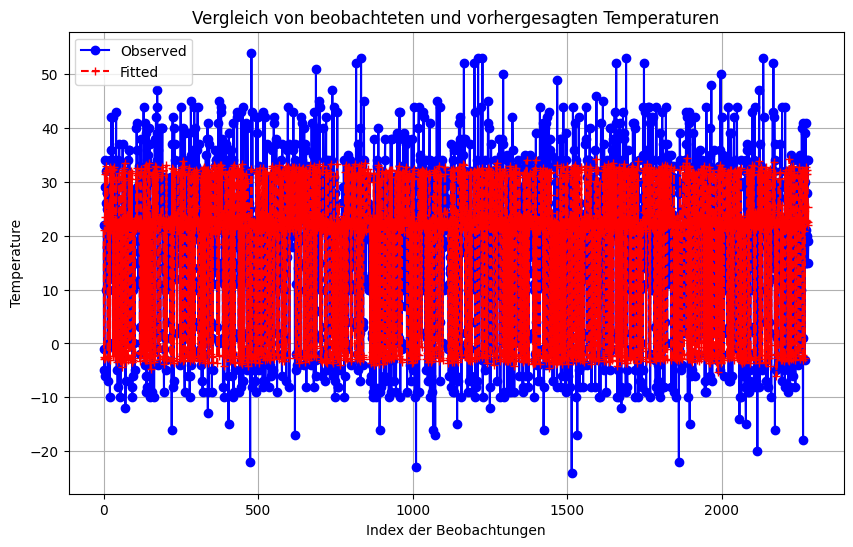

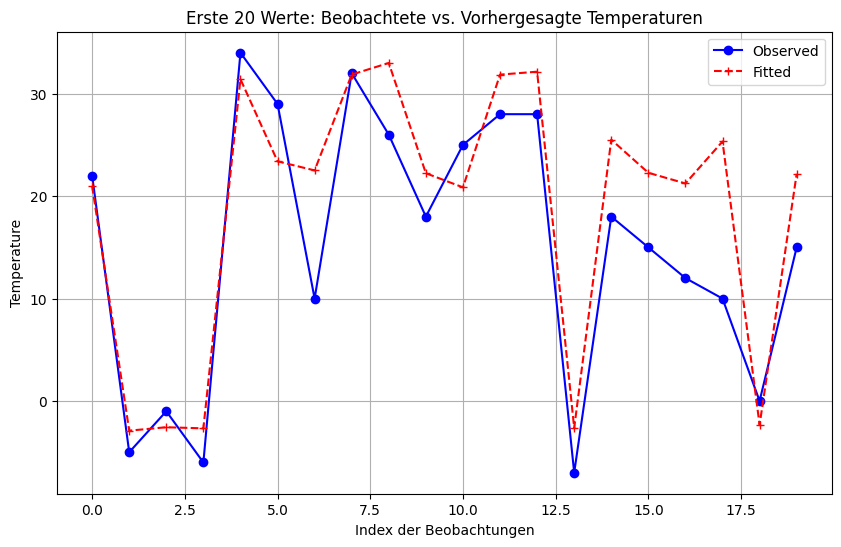

Mean Squared Error (MSE) - Test: 67.87231994181
R² - Test: 0.7100239719291634
AIC - Model: 64194.32791560294


In [50]:
#3. Season_Spring entfernen
model = smf.ols(formula='Temperature ~ Humidity + Wind_Speed + flag_precip_45_plus:Precipitation_ + Atmospheric_Pressure + UV_Index + I(UV_Index ** 2) + Visibility_km + Cloud_Cover_clear + Cloud_Cover_cloudy + Cloud_Cover_overcast + Cloud_Cover_partly_cloudy  + Season_Summer	+ Season_Autumn + Season_Winter + Location_inland + Location_coastal + Location_mountain + Weather_Type_Cloudy + Weather_Type_Rainy +	Weather_Type_Snowy + Weather_Type_Sunny', data=df_train_temp).fit()
print(model.summary())
print("\n\nAIC=",model.aic)
# Residuen erneut analysieren
df_train_temp['fitted'] = model.fittedvalues
df_train_temp['residuals'] = model.resid

# Residuen berechnen
residuals = model.resid

# MSE berechnen
mse = (residuals ** 2).mean()
print(f"Mean Squared Error (MSE): {mse}")

df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp
df_test_temp['fitted'] = model.predict(df_test_temp)

# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted', main="Vergleich von beobachteten und vorhergesagten Temperaturen")

# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")

# R², MSE und AIC für die Testdaten berechnen
mse_test = ((df_test_temp['Temperature'] - df_test_temp['fitted']) ** 2).mean()
r_squared_test = r2_score(df_test_temp['Temperature'], df_test_temp['fitted'])
aic_test = model.aic  # AIC bleibt vom Modelltrainingsprozess gleich, wird nicht separat für Testdaten berechnet

print(f"Mean Squared Error (MSE) - Test: {mse_test}")
print(f"R² - Test: {r_squared_test}")
print(f"AIC - Model: {aic_test}")

## 4.4 Beste Regression

Hier wird nun die beste der gefundenen Regressionen angezeigt, welche später dann mit den anderen Modellen verglichen wird. 

Es muss allerdings beachtet werden dass dies nicht die bestmögliche Regression sein muss, da nur eine begrenzte Anzahl an Variablenkombinationen getestet werden kann. So wurden beispielsweise Flags für Atmospheric Pressure in Erwägung gezogen, da dies in der Grafik als mögliche Verbesserung herausgelesen werden kann, wurde allerdings aufgrund einer Verschlechterung der Modellwerte wieder entfernt. Auch das Herauslassen verschiedener Dummy-VAriablen wurde getestet. Es ist jedoch möglich dass in Kombination mit einem weiteren Flag oder dem Löschen von anderen die Werte verbessert hätte. Dies könnte zum Beispiel mit einer For-Schleife mit welcher über mit denkbaren Flags und Variablen alle Varianten testet und die Beste ausgibt. Hierauf wurde aber aufgrund von Rechenleistung und ZEit verzichtet, da in diesem Projekt auf das Prinzip der Linearen Regression eingegangen werden sollte.

                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.714
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     1263.
Date:                Mon, 26 May 2025   Prob (F-statistic):               0.00
Time:                        12:11:42   Log-Likelihood:                -32078.
No. Observations:                9127   AIC:                         6.419e+04
Df Residuals:                    9108   BIC:                         6.433e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
Inte

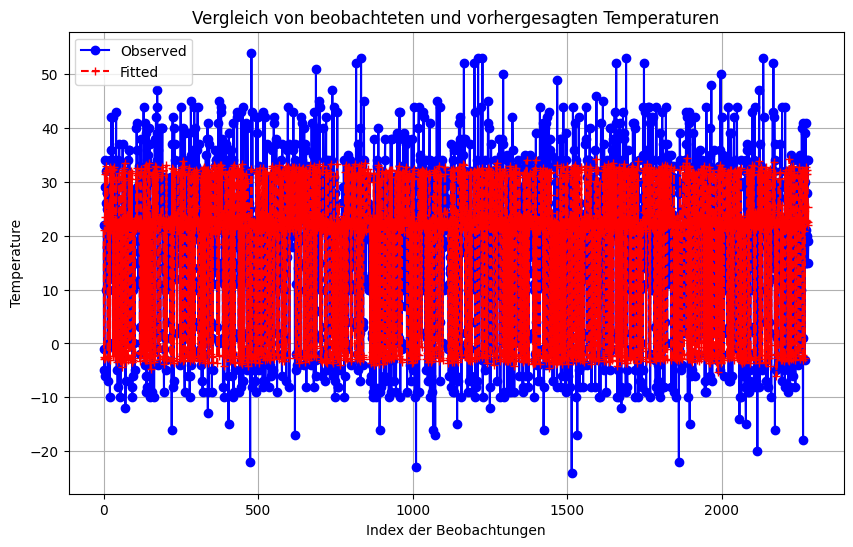

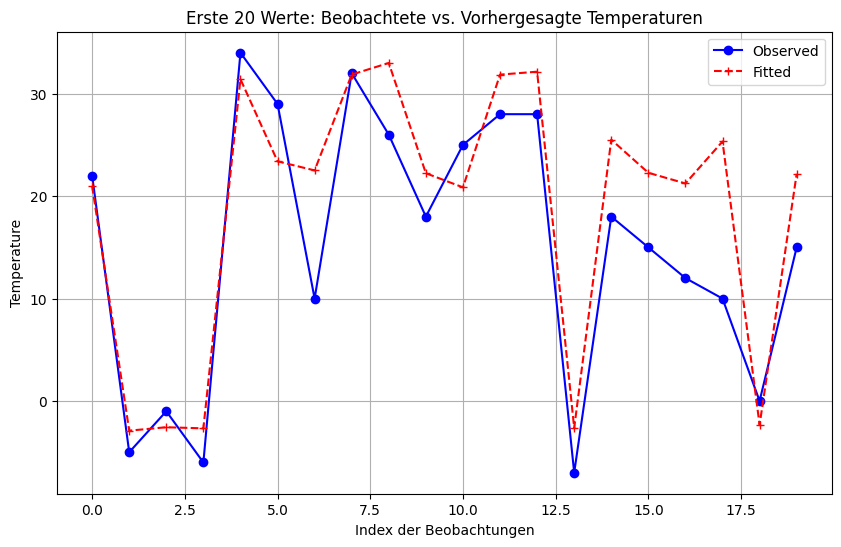

Mean Squared Error (MSE) - Test: 67.87231994181
R² - Test: 0.7100239719291634
AIC - Model: 64194.32791560294


In [51]:
#3. Beste gefundenene Regression
model = smf.ols(formula='Temperature ~ Humidity + Wind_Speed + flag_precip_45_plus:Precipitation_ + Atmospheric_Pressure + UV_Index + I(UV_Index ** 2) + Visibility_km + Cloud_Cover_clear + Cloud_Cover_cloudy + Cloud_Cover_overcast + Cloud_Cover_partly_cloudy  + Season_Summer	+ Season_Autumn + Season_Winter + Location_inland + Location_coastal + Location_mountain + Weather_Type_Cloudy + Weather_Type_Rainy +	Weather_Type_Snowy + Weather_Type_Sunny', data=df_train_temp).fit()
print(model.summary())
print("\n\nAIC=",model.aic)
# Residuen erneut analysieren
df_train_temp['fitted'] = model.fittedvalues
df_train_temp['residuals'] = model.resid

# Residuen berechnen
residuals = model.resid

# MSE berechnen
mse = (residuals ** 2).mean()
print(f"Mean Squared Error (MSE): {mse}")

df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp
df_test_temp['fitted'] = model.predict(df_test_temp)

# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted', main="Vergleich von beobachteten und vorhergesagten Temperaturen")

# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")

# R², MSE und AIC für die Testdaten berechnen
mse_test = ((df_test_temp['Temperature'] - df_test_temp['fitted']) ** 2).mean()
r_squared_test = r2_score(df_test_temp['Temperature'], df_test_temp['fitted'])
aic_test = model.aic  # AIC bleibt vom Modelltrainingsprozess gleich, wird nicht separat für Testdaten berechnet

print(f"Mean Squared Error (MSE) - Test: {mse_test}")
print(f"R² - Test: {r_squared_test}")
print(f"AIC - Model: {aic_test}")

In [52]:
#Zusammenfassung aller zum späteren Vergleich verwendeten Werte

r2_reg = metrics.r2_score(y_test_temp, df_test_temp['fitted'])
mae_reg = metrics.mean_absolute_error(y_test_temp, df_test_temp['fitted'])
mse_reg = metrics.mean_squared_error(y_test_temp, df_test_temp['fitted'])
rmse_reg = rmse_lgbm = np.sqrt(mse_reg)
mape_reg = metrics.mean_absolute_percentage_error(y_test_temp, df_test_temp['fitted'])

print('R2:',r2_reg)
print('Mean Absolute Error:',mae_reg)
print('Mean Squared Error:',mse_reg)
print('Root Mean Squared Error:',rmse_reg)
print('Mean Absolute Percentage Error:',mape_reg)

R2: 0.7100239719291634
Mean Absolute Error: 6.4325536333114135
Mean Squared Error: 67.87231994181
Root Mean Squared Error: 8.238465873074308
Mean Absolute Percentage Error: 202443306379560.56


# 5. Random Forest

Im ersten Schritt erstellen wir einen einfachen Decision Tree, um ein Gefühl für den Umgang mit einem Random Forest zu bekommen.

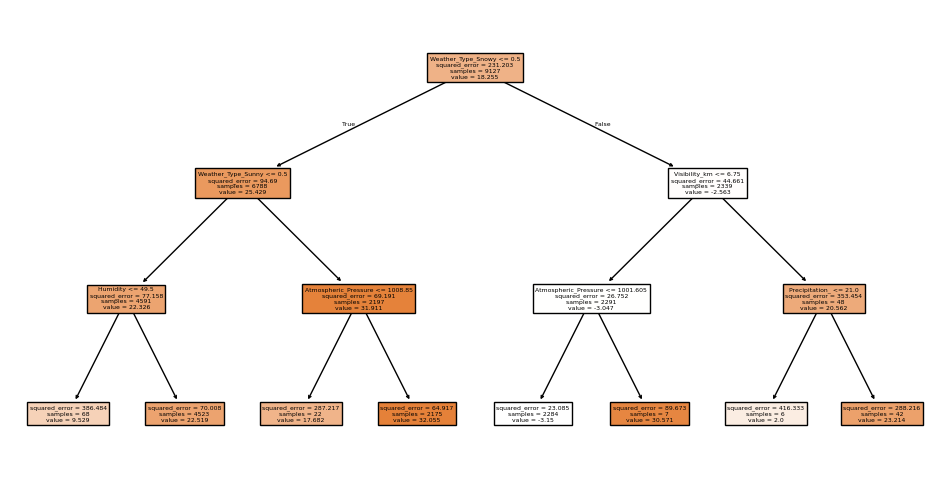

In [53]:
# Entscheidungsbaum definieren
model_dectree = DecisionTreeRegressor(max_depth = 3, random_state = 0)

# Entscheidungsbaum mit Daten trainieren
model_dectree.fit(X_train_temp, y_train_temp)

# Entscheidungsbaum darstellen
fig = plt.figure(figsize=(12,6))
plot_tree(model_dectree, filled = True,feature_names = X_train_temp.columns)
plt.show()

Wir nutzten `GridSearchCV` um optimalen Hyperparameter für unseren Random Forest zu erhalten.

In [ ]:
#Aufgrund von Laufzeit auskommentiert

""""

# Parameter-Grid definieren (Achtung: je mehr Möglichkeiten man zulässt, desto länger dauert die Grid-Search!
params = {
    'n_estimators': [50, 100 , 200],  # Reduzierte Anzahl an Bäumen
    'max_depth': [4, 7 ,15],  # Weniger Tiefe für schnellere Ergebnisse
    'min_samples_split': [10, 20, 30],  # Weniger Optionen für min_samples_split
    'min_samples_leaf': [2, 5, 10],  # Weniger Optionen für min_samples_leaf
    'max_leaf_nodes': [20, 30, 40]  # Weniger Optionen für max_leaf_nodes
}

# Initialisiere den Random Forest Regressor
rf = RandomForestRegressor(random_state=42)

# Initialisiere GridSearchCV mit 5-facher Kreuzvalidierung
grid_search = GridSearchCV(estimator=rf, param_grid=params, cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')

# Grid-Search starten
grid_search.fit(X_train_temp, y_train_temp)

# beste Hyperparameter-Kombination
grid_search.best_params_
"""

Da `GridSearchCV` trotz dem Ausprobieren unterschiedlich großer Parameterwerte zu lange benötigt hat, verwenden wir stattdessen `optuna`, um annähernd optimale Hyperparameter für unseren Random Forest zu ermitteln.

Die Parameter wurden iterativ angepasst, um mit `optuna` die bestmöglichen Werte zu finden.

In [54]:
# Setze die Logging-Stufe auf WARNING, um weniger Output zu erhalten
optuna.logging.set_verbosity(optuna.logging.WARNING)

# Setze einen globalen Seed für Reproduzierbarkeit
SEED = 42

# Ziel-Funktion für Optuna definieren
def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', low=100, high=300, step=10)  # Anzahl der Bäume
    max_depth = trial.suggest_int('max_depth', low=4, high=8, step=1)  # Sequenz für max_depth
    min_samples_split = trial.suggest_categorical('min_samples_split', [4, 10, 20, 30, 40, 50, 60, 70, 80])
    min_samples_leaf = trial.suggest_categorical('min_samples_leaf', [10, 12, 15, 20])
    max_leaf_nodes = trial.suggest_categorical('max_leaf_nodes', [10, 20, 25, 30, 35, 40, 50])

    model = DecisionTreeRegressor(
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_leaf_nodes=max_leaf_nodes,
        random_state=SEED  # Setze den Seed für das Modell
    )

    # Cross-Validation mit festem Seed für Reproduzierbarkeit
    cv = KFold(n_splits=5, shuffle=True, random_state=SEED)
    score = cross_val_score(model, X_train_temp, y_train_temp, cv=cv, scoring='r2').mean()
    return score

# Optuna-Studie erstellen und optimieren, Sampler mit Seed
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=SEED))
study.optimize(objective, n_trials=200)

# Beste Parameter und Ergebnisse anzeigen
print("Beste Parameter: ", study.best_params)
print("Bestes R2: ", study.best_value)

Beste Parameter:  {'n_estimators': 180, 'max_depth': 8, 'min_samples_split': 70, 'min_samples_leaf': 12, 'max_leaf_nodes': 20}
Bestes R2:  0.7349969221595425


Trotz des Versuchs, durch die Verwendung eines `random_state`-Seeds identische Parameter bei wiederholter Ausführung des Codes zu erzielen, war dies aufgrund der Berechnungsweise, die von `optuna` durchgeführt wird, nicht möglich. Daher entschieden wir uns, die besten erzielten Ergebnisse manuell zu speichern, um nicht mit wechselnden Ergebnissen arbeiten zu müssen.

Als "optimale Parameter" haben wir folgende gewählt:

*   `n_estimators`: 180
*   `max_depth`: 8
*   `min_samples_split`: 70
*   `min_samples_leaf`: 12
*   `max_leaf_nodes`: 20
                  
Bestes R2:  0.7349969221595425

In [55]:
new_study_best_params = {'n_estimators': 180, 'max_depth': 8, 'min_samples_split': 70, 'min_samples_leaf': 12, 'max_leaf_nodes': 20}

Im nächsten Schritt kann das Random-Forest-Modell mit den "optimalen" Parametern trainiert werden.

In [56]:
# Finales Modell mit besten Parametern trainieren
model_rf_final = RandomForestRegressor(**new_study_best_params, random_state=0)
model_rf_final.fit(X_train_temp, y_train_temp)

RandomForestRegressor(max_depth=8, max_leaf_nodes=20, min_samples_leaf=12,
                      min_samples_split=70, n_estimators=180, random_state=0)

In [57]:
# Prognose für Testdaten
df_test_temp['fitted_rf'] = model_rf_final.predict(X_test_temp)

Nun werden die Prognosedaten anhand der verschiedenen Kennwerte beurteilt:

In [58]:
r2_rf = metrics.r2_score(y_test_temp, df_test_temp['fitted_rf'])
mae_rf = metrics.mean_absolute_error(y_test_temp, df_test_temp['fitted_rf'])
mse_rf = metrics.mean_squared_error(y_test_temp, df_test_temp['fitted_rf'])
rmse_rf = rmse_rf = np.sqrt(mse_rf)
mape_rf = metrics.mean_absolute_percentage_error(y_test_temp, df_test_temp['fitted_rf'])

print('R2:',r2_rf)
print('Mean Absolute Error:',mae_rf)
print('Mean Squared Error:',mse_rf)
print('Root Mean Squared Error:',rmse_rf)
print('Mean Absolute Percentage Error:',mape_rf)

R2: 0.7281031234523313
Mean Absolute Error: 6.3642795215063535
Mean Squared Error: 63.64068064176018
Root Mean Squared Error: 7.977510930218784
Mean Absolute Percentage Error: 230499749034907.16


Die prognostizierten Temperaturwerte werden mit den tatsächlichen Werten des Testdatensatzes verglichen. Um das Diagramm übersichtlicher zu gestalten, werden nur die ersten 20 Werte angezeigt.

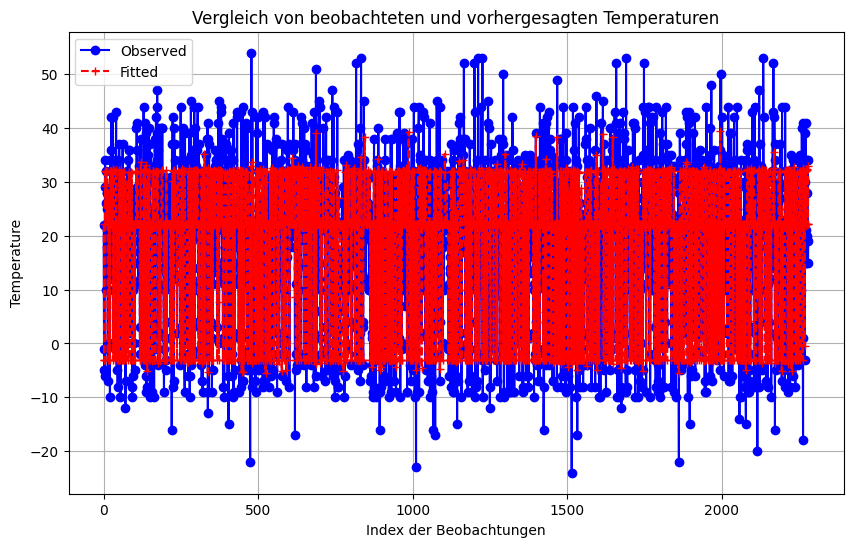

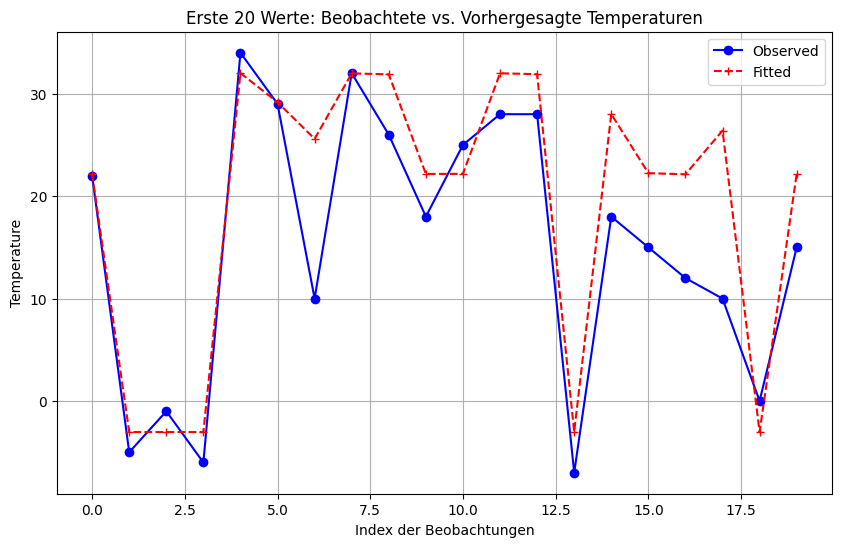

In [59]:
# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted_rf', main="Vergleich von beobachteten und vorhergesagten Temperaturen")
# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted_rf', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")


# 6. Light GBM - Modell

Wir verwenden sofort `optuna`, um "optimale" Parameterwerte für unser Light GBM-Modell zu finden, da `GridSearchCV` auch hier eine lange Ausführungszeit in Anspruch nehmen würde. 

Die Parameter wurden iterativ angepasst, um mit `optuna` die bestmöglichen Werte zu finden.

In [60]:
# Setze die Logging-Stufe auf WARNING, um weniger Output zu erhalten
optuna.logging.set_verbosity(optuna.logging.WARNING)

# Setze einen globalen Seed für Reproduzierbarkeit
SEED = 42

# Ziel-Funktion für Optuna definieren
def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', low=100, high=300, step=10)
    learning_rate = trial.suggest_float('learning_rate', low=0.01, high=0.3, step=0.005)
    max_depth = trial.suggest_int('max_depth', low=4, high=8, step=1)
    min_child_samples = trial.suggest_categorical('min_samples_leaf', [10, 12, 15, 20])
    num_leaves = trial.suggest_categorical('num_leaves', [10, 20, 25, 30, 35, 40, 50])

    model = LGBMRegressor(
        max_depth=max_depth,
        num_leaves=num_leaves,
        learning_rate=learning_rate,
        n_estimators=n_estimators,
        min_child_samples=min_child_samples,
        random_state=SEED,
        verbose=-1
    )

    # Cross-Validation mit festem Seed für Reproduzierbarkeit
    cv = KFold(n_splits=5, shuffle=True, random_state=SEED)
    score = cross_val_score(model, X_train_temp, y_train_temp, cv=cv, scoring='r2').mean()
    return score

# Optuna-Studie erstellen und optimieren, Sampler mit Seed
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=SEED))
study.optimize(objective, n_trials=100)

# Beste Parameter und Ergebnisse anzeigen
print("Beste Parameter: ", study.best_params)
print("Bestes R2: ", study.best_value)

Beste Parameter:  {'n_estimators': 220, 'learning_rate': 0.02, 'max_depth': 7, 'min_samples_leaf': 20, 'num_leaves': 10}
Bestes R2:  0.7368824564056597


Trotz des Versuchs, durch die Verwendung eines `random_state`-Seeds identische Parameter bei wiederholter Ausführung des Codes zu erzielen, war dies aufgrund der Berechnungsweise, die von `optuna` durchgeführt wird, nicht möglich. Daher entschieden wir uns, die besten erzielten Ergebnisse manuell zu speichern, um nicht mit wechselnden Ergebnissen arbeiten zu müssen.

Als "optimale Parameter" haben wir folgende gewählt:

*   `n_estimators`: 220
*   `learning_rate`: 0.02
*   `max_depth`: 7
*   `min_samples_leaf`: 20
*   `num_leaves`: 10
                  
Bestes R2:  0.7368824564056597

In [61]:
new_study_best_params = {'n_estimators': 220, 'learning_rate': 0.02, 'max_depth': 7, 'min_samples_leaf': 20, 'num_leaves': 10}

Im nächsten Schritt kann das Light GBM-Modell mit den "optimalen" Parametern trainiert werden.

In [62]:
# Finales Modell mit besten Parametern trainieren
model_lgbm_final = LGBMRegressor(**new_study_best_params, random_state=0,verbose=-1)
model_lgbm_final.fit(X_train_temp, y_train_temp)

LGBMRegressor(learning_rate=0.02, max_depth=7, min_samples_leaf=20,
              n_estimators=220, num_leaves=10, random_state=0, verbose=-1)

In [63]:
# Prognose für Testdaten
df_test_temp['fitted_lgbm'] = model_lgbm_final.predict(X_test_temp)

Nun werden die Prognosedaten anhand der verschiedenen Kennwerte beurteilt:

In [64]:
r2_lgbm = metrics.r2_score(y_test_temp, df_test_temp['fitted_lgbm'])
mae_lgbm = metrics.mean_absolute_error(y_test_temp, df_test_temp['fitted_lgbm'])
mse_lgbm = metrics.mean_squared_error(y_test_temp, df_test_temp['fitted_lgbm'])
rmse_lgbm = rmse_lgbm = np.sqrt(mse_lgbm)
mape_lgbm = metrics.mean_absolute_percentage_error(y_test_temp, df_test_temp['fitted_lgbm'])

print('R2:',r2_lgbm)
print('Mean Absolute Error:',mae_lgbm)
print('Mean Squared Error:',mse_lgbm)
print('Root Mean Squared Error:',rmse_lgbm)
print('Mean Absolute Percentage Error:',mape_lgbm)

R2: 0.7285251719362507
Mean Absolute Error: 6.349747355900498
Mean Squared Error: 63.54189520103908
Root Mean Squared Error: 7.971317030518802
Mean Absolute Percentage Error: 208638432104841.06


Die prognostizierten Temperaturwerte werden mit den tatsächlichen Werten des Testdatensatzes verglichen. Um das Diagramm übersichtlicher zu gestalten, werden nur die ersten 20 Werte angezeigt.

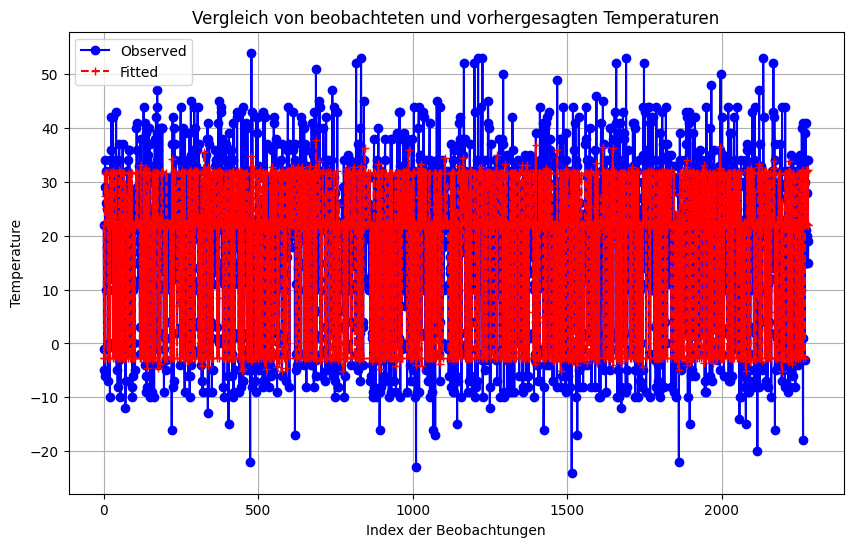

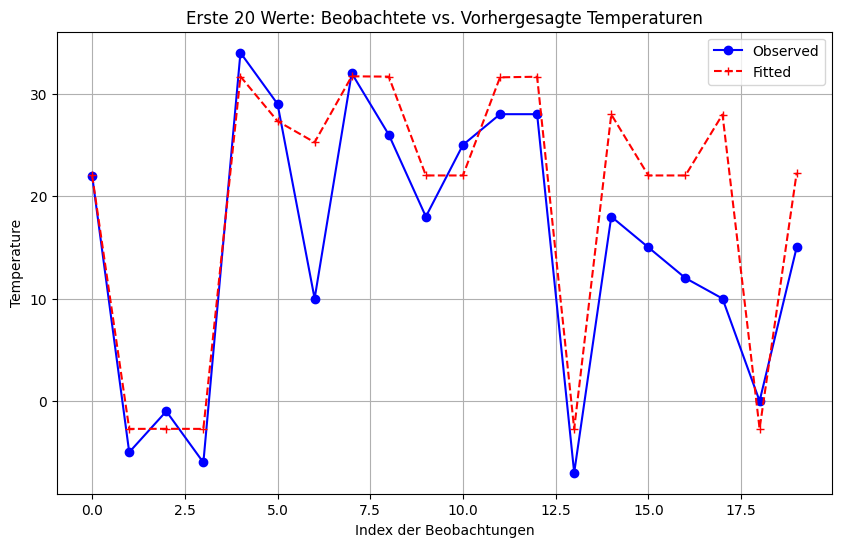

In [65]:
# Modell-Vergleich aufrufen
plot_compare_model_complete(df_test_temp, y_var='Temperature', y_forecast='fitted_lgbm', main="Vergleich von beobachteten und vorhergesagten Temperaturen")

# Plot für die ersten 20 Werte
df_test_temp_first_20 = df_test_temp.iloc[:20].copy()

plot_compare_model_complete(df_test_temp_first_20, y_var='Temperature', y_forecast='fitted_lgbm', main="Erste 20 Werte: Beobachtete vs. Vorhergesagte Temperaturen")

# 7. Vergleich der verschiedenen Modelle

Im ersten Schritt werden Funktionen definiert um die 3-Modelle miteinander vergleichen zu können:

In [66]:
# eine nützliche Funktion, um den Fit eines Modells grafisch zu prüfen!
def plot_compare_model_3(data, x_var, y_var, y_forecast_mod1, y_forecast_mod2, y_forecast_mod3, n_groups,label_mod1,label_mod2,label_mod3,main=""):
    plt.figure(figsize=(10,6))
    #Kopie der Daten anlegen, weil sonst Original-DataFrame bearbeitet wird
    data_plot = data.copy()
    #group data
    data_plot['xvar_group'] = pd.qcut(data_plot[x_var],q=n_groups,labels=False, duplicates='drop')
    #group observed
    xvar_o = data_plot.groupby('xvar_group')[x_var].mean()
    yvar_o = data_plot.groupby('xvar_group')[y_var].mean()
    # group fitted
    yvar_fm1 = data_plot.groupby('xvar_group')[y_forecast_mod1].mean()
    yvar_fm2 = data_plot.groupby('xvar_group')[y_forecast_mod2].mean()
    yvar_fm3 = data_plot.groupby('xvar_group')[y_forecast_mod3].mean()
    #plot
    plt.plot(xvar_o, yvar_o,marker='o',label='Observed')
    plt.plot(xvar_o, yvar_fm1,marker='+',label=label_mod1)
    plt.plot(xvar_o, yvar_fm2,marker='',label=label_mod2)
    plt.plot(xvar_o, yvar_fm3,marker='',label=label_mod3)
    plt.title(main)
    plt.legend()
    plt.grid()
    plt.show()

Die wichtigsten Kennzahlen zur Bestimmung der Effektivität der drei Modelle werden hier noch einmal in einer Tabelle angezeigt, um diese besser vergleichen zu können.

In [67]:
# Zusammenfassung der jeweiligen Modell-Kennzahlen
reg_metrics = {'R2': r2_reg, 'MAE': mae_reg, 'MSE': mse_reg, 'RMSE': rmse_reg,
                  'MAPE': mape_reg}
rf_metrics = {'R2': r2_rf, 'MAE': mae_rf, 'MSE': mse_rf, 'RMSE': rmse_rf,
                  'MAPE': mape_rf}
lgbm_metrics = {'R2': r2_lgbm, 'MAE': mae_lgbm, 'MSE': mse_lgbm, 'RMSE': rmse_lgbm,
                  'MAPE': mape_lgbm}
 
# Dictionary mit den Modellnamen als Schlüsseln und den Kennzahlen als Werten
model_metrics = {
    'Regression': reg_metrics,
    'Random Forest': rf_metrics,
    'LightGBM': lgbm_metrics
}
 
# Dictionary in ein Pandas DataFrame konvertieren
df = pd.DataFrame(model_metrics).T.round(3)
 
# DataFrame ausgeben
df

,R2,MAE,MSE,RMSE,MAPE
Regression,0.710,6.433,67.872,8.238,2.024433e+14
Random Forest,0.728,6.364,63.641,7.978,2.304997e+14
LightGBM,0.729,6.350,63.542,7.971,2.086384e+14


Zusätzlich zu den Kennzahlen, die zur Beurteilung der Modelle verwendet werden, betrachten wir die ersten 20 Werte der tatsächlich gemessenen Temperaturen sowie die Prognosen der verschiedenen Modelle. Dadurch kann man graphisch erkennen, wie groß die einzelnen Abweichungen sind.

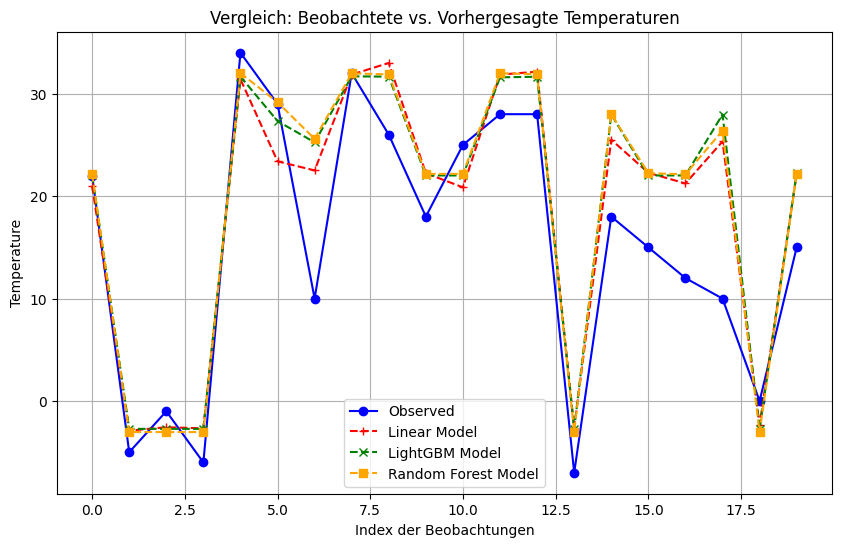

In [68]:
def plot_compare_model_allModels(data, y_var, y_forecast_list, forecast_labels, main=""):
    plt.figure(figsize=(10, 6))
    
    # Plot der beobachteten Werte
    plt.plot(data[y_var].values, label='Observed', marker='o', linestyle='-', color='blue')
    
    # Plot der verschiedenen Vorhersagen
    colors = ['red', 'green', 'orange']  # Farben für die verschiedenen Modelle
    markers = ['+', 'x', 's']  # Marker-Stile für die verschiedenen Modelle

    for i, y_forecast in enumerate(y_forecast_list):
        plt.plot(data[y_forecast].values, label=forecast_labels[i], marker=markers[i], linestyle='--', color=colors[i])
    
    # Plot-Einstellungen
    plt.title(main)
    plt.xlabel('Index der Beobachtungen')
    plt.ylabel(y_var)
    plt.legend()
    plt.grid(True)
    plt.show()

# Annehmen, dass df_test_temp bereits die Vorhersagen aus verschiedenen Modellen enthält
df_test_temp = X_test_temp.copy()
df_test_temp['Temperature'] = y_test_temp


# Labels für die Legende
forecast_labels = ['Linear Model', 'LightGBM Model', 'Random Forest Model']

# Vergleich aller Vorhersagen mit den beobachteten Werten
plot_compare_model_allModels(df_test_temp_first_20, y_var='Temperature', y_forecast_list=['fitted', 'fitted_lgbm', 'fitted_rf'], forecast_labels=forecast_labels, main="Vergleich: Beobachtete vs. Vorhergesagte Temperaturen")

# Fazit

Alle drei Modelle sind zur Prognose von Temperaturen geeignet. Dabei weisen das LGBM-Modell und der Random Forest die vielversprechendsten Kennzahlen auf. Wenn man sich zusätzlich noch die grafische Darstellung der ersten 20 Werte anschaut, schneidet das LGBM-Modell am vielversprechendsten ab. Daher würden wir das LGBM-Modell bevorzugen, auch weil die lineare Regression mehr 'Handarbeit' erfordert. Es muss allerdings bedacht werden dass durch Grid-Search der Random Forest sowie durch weitere Versuche mit anderen Reihenfolgen zur Entfernung der (Dummy)Variablen bei der Linearen Regression bessere Ergebnisse erziehlt werden können.